# Projet 3: prédiction de la consommation totale d'énergie

<B>Objectif</B>: on cherche à prédire la variable 'SiteEnergyUse(kBtu)' ou sa transformation via la fonction logarithme 'ln_consommation' à l'aide des données structurelles des bâtiments. 

<B>Remarque</B>: au cours de ce projet on cherche également à évaluer l'intéret de l'ENERGY STAR Score pour la prédiction des <U>émissions</U>. Mais si on décide d'obtenir l'ENERGY STAR Score de bâtiments pour prédire les émissions, et bien autant sans servir pour prédire la consommation s'il fonctionne bien aussi pour cela. Donc nous vérifierons aussi l'impact de l'ENERGY STAR Score sur la prédiction de la consommation.

Au cours de l'analyse exploratoire nous avons constitué deux jeux de données. Le premier, que nous noterons 'data', conserve la structure du jeu de donnée d'origine en ce qui concerne les variables indiquant l'usage des bâtiments. Dans le second, que nous noterons 'df', nous avons remplacé ces variables par d'autres, toutes numériques.

Nous effectuerons des prédictions sur ces deux jeux de données afin de voir si le feature engineering effectué sur les catégories de bâtiments améliore les prédictions. 

# Importation des éléments de travails

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import make_column_transformer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn import dummy
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import ElasticNet
from sklearn import kernel_ridge
import xgboost as xgb
import timeit

C:\Users\tony.mathieux\anaconda3\envs\machine_learning\lib\site-packages\xgboost\compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


In [2]:
data = pd.read_csv("data_pour_ML.csv") # fichier avec les variables LargestPropertyUseType, SecondLargestPropertyUseType ...
pd.set_option("display.max_columns", 50)
data.head()

,OSEBuildingID,PrimaryPropertyType,PropertyName,CouncilDistrictCode,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEnergyUse(kBtu),TotalGHGEmissions,distance_from_City_Hall,proportion_elec,ln_consommation,ln_emissions
0,1,lodging,Mayflower park hotel,7,1927.0,1.0,12.0,0.0,88434.0,lodging,88434.0,aucun,0.0,aucun,0.0,60.0,7226362.5,249.98,1.110872,0.87,15.793246,5.525373
1,2,lodging,Paramount Hotel,7,1996.0,1.0,11.0,15064.0,88502.0,lodging,83880.0,non refrigerated warehouse,15064.0,restauration,4622.0,61.0,8387933.0,295.86,1.081613,0.37,15.942305,5.693261
2,5,lodging,HOTEL MAX,7,1926.0,1.0,10.0,0.0,61320.0,lodging,61320.0,aucun,0.0,aucun,0.0,56.0,6794584.0,286.43,1.250795,0.62,15.731637,5.660979
3,8,lodging,WARWICK SEATTLE HOTEL (ID8),7,1980.0,1.0,18.0,62000.0,113580.0,lodging,123445.0,non refrigerated warehouse,68009.0,other,0.0,75.0,14172606.0,505.01,1.358169,0.37,16.466822,6.226556
4,9,other,West Precinct,7,1999.0,1.0,2.0,37198.0,60090.0,office,88830.0,aucun,0.0,aucun,0.0,NaN,12086616.0,301.81,1.466682,0.62,16.307609,5.713106


In [3]:
df = pd.read_csv('data_ML_ameliore.csv') # fichier avec les variables de catégories de bâtiments leisure, mall, medical...
df.head()

,OSEBuildingID,PrimaryPropertyType,PropertyName,CouncilDistrictCode,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFAParking,PropertyGFABuilding(s),ENERGYSTARScore,SiteEnergyUse(kBtu),TotalGHGEmissions,distance_from_City_Hall,proportion_elec,ln_consommation,ln_emissions,education,leisure,lodging,mall,medical,non refrigerated warehouse,office,other,refrigerated warehouse,restauration,services,store
0,1,lodging,Mayflower park hotel,7,1927.0,1.0,12.0,0.0,88434.0,60.0,7226362.5,249.98,1.110872,0.87,15.793246,5.525373,0.0,0.0,88434.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2,lodging,Paramount Hotel,7,1996.0,1.0,11.0,15064.0,88502.0,61.0,8387933.0,295.86,1.081613,0.37,15.942305,5.693261,0.0,0.0,83880.0,0.0,0.0,15064.0,0.0,0.0,0.0,4622.0,0.0,0.0
2,5,lodging,HOTEL MAX,7,1926.0,1.0,10.0,0.0,61320.0,56.0,6794584.0,286.43,1.250795,0.62,15.731637,5.660979,0.0,0.0,61320.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,8,lodging,WARWICK SEATTLE HOTEL (ID8),7,1980.0,1.0,18.0,62000.0,113580.0,75.0,14172606.0,505.01,1.358169,0.37,16.466822,6.226556,0.0,0.0,123445.0,0.0,0.0,68009.0,0.0,0.0,0.0,0.0,0.0,0.0
4,9,other,West Precinct,7,1999.0,1.0,2.0,37198.0,60090.0,NaN,12086616.0,301.81,1.466682,0.62,16.307609,5.713106,0.0,0.0,0.0,0.0,0.0,0.0,88830.0,0.0,0.0,0.0,0.0,0.0


# Plan de l'étude

Pour tester la pertinence du feature engineering effectué sur les catégories de bâtiments et pour évaluer l'intérêts de l'ENERGY STAR Score, nous testerons des modèles de machine learning successivement sur:

<ul>
    <li>data, sans ENERGY STAR Score</li>
    <li>data, avec ENERGY STAR Score</li>
    <li>df, sans ENERGY STAR Score</li>
    <li>df, avec ENERGY STAR Score</li>
</ul>

Dans chaque cas nous testerons les modèles suivant (à moins qu'une bonne raison n'élimine le modèle):

<ul>
    <li>Random forest</li>
    <li>KRR à noyau linéaire</li>
    <li>KRR à noyau gaussien</li>
    <li>ElasticNet</li>
    <li>Gradient boosting</li>
    <li>Réseaux de neurones</li>
</ul>

On effectura une démarche similaire pour chaque modèle, hormis les réseaux de neurones car ceux-ci s'intégrerons mal à la fonction test_model ci-dessous destinée à automatiser les tests.

In [4]:
# Afin d'avoir des résultats reproductibles et d'entraîner les différents modèle sur les même données d'entraînement on définit
# les contantes suivantes
rand_init = 3 # random_state de la fonction train_test_split
cv = 5 # paramètre cv de GridSearchCV

In [5]:
def test_model(X, Y, test_size, rand_init, num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, graph, print_option=True):
    '''
    Renvoie le modèle 'model' entraîné, le temps d'entraînement, le r2_score sur le jeu de test et la 'mean absolute error',
    sur le jeu de test.
    
    Paramètres
    ----------
    X : le jeu de données
    Y : la variable à prédire
    test_size : le paramètre test_size de la fonction train_test_split
    rand_init : le paramètre random_state de la fonction train_test_split
    num_encoder: un encoder pour les variables numériques
    var_num_encoder : les variables de X à encoder avec num_encoder
    categ_encoder: un encoder pour les variables catégorielles
    var_categ_encoder : les variables de X à encoder avec categ_encoder
    model : le modèle à tester
    graph : booléen, si True alors la fonction test_model tracera le graph des valeurs prédites par le modèle sur le jeu de test
        ainsi que les valeurs réels
    print_option : booléen, True par défaut, écrit le temps d'entraînement, le r2_score sur le jeu de test et
        la 'mean absolute error', sur le jeu de test 
    '''
    start_time = timeit.default_timer()
    X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size=test_size, random_state=rand_init)
    ct = make_column_transformer((num_encoder, var_num_encoder),(categ_encoder, var_categ_encoder))
    ct.fit(X_train)
    X_train_encoder = ct.transform(X_train)
    model.fit(X_train_encoder, Y_train)
    temps = timeit.default_timer() - start_time
    
    y_pred = model.predict(ct.transform(X_test))
    R2 = metrics.r2_score(Y_test, y_pred)
    mae = metrics.mean_absolute_error(Y_test, y_pred)
    if print_option == True:
        print("Temps d'entrainement: {}".format(temps))
        print( "R2 score : {}".format(R2))
        print( "mae : {}".format(mae))
    if graph == True:
        plt.figure(figsize=(16,8))
        plt.plot(range(0,len(Y_test)),y_pred[:], color='blue', label='prédiction')
        plt.plot(range(0,len(Y_test)),Y_test[:], color='orange', label='réel')
        plt.legend(loc="upper right")
    return [model, temps, R2, mae]

In [6]:
# Création d'un tableau pour stocker les résultats (temps d'exécution, r2_score et mae) des différents modèles
# Un modèle par ligne, mais deux prédiction: 'SiteEnergyUse(kBtu)' et 'ln_consommation'
noms_col = ['modèle','temps d\'éxécution', 'R2_score', 'mae','temps d\'éxécution ln', 'R2_score ln', 'mae ln']
mes_modeles = pd.DataFrame(columns = noms_col)

In [7]:
def add_line_to_modeles(df, liste1, nom_col_1, liste2):
    """
    Ajoute au dataframe df une nouvelle ligne formée à partir des listes liste1 et liste2
    
    Paramètres
    ----------
    df : il s'agira du dataframe 'mes_modeles'
    liste1 : fonction test_model pour une prédiction de 'SiteEnergyUse(kBtu)'
    liste2 : fonction test_model pour une prédiction de 'ln_consommation'
    nom_col_1 : nom du modèle
    """
    L1 = liste1.copy()
    L2 = liste2.copy()
    L1[0] = nom_col_1
    del L2[0]
    df.loc[len(df.index)] = L1 + L2

En général, un test se déroulera de la manière suivante:
<ol>
    <li>Initialisation d'une grille d'hyperparamètre si le test comporte une validation croisée via la fonction 'GridSearchCV'.</li>
    <li>Initialisation du modèle.</li>
    <li>Appel de la fonction test_model pour prédire 'SiteEnergyUse(kBtu)'.</li>
    <li>Appel de la fonction test_model pour prédire 'ln_consommation'.</li>
    <li>Appel de la fonction add_line_to_modeles pour compléter le tableau récapitulatif des tests.</li>
</ol>

De plus, à la suite d'un test avec 'GridSearchCV' on fera un test avec des hyperparamètres testés dans le 'GridSearchCV' qui n'étaient pas optimaux afin de voir la différence.

Enfin on regardera la feature importance quand nous testerons les modèles sur le jeu de donnée df, mais pas avec data à cause du 'one_hot_encoding' qui pose problème.

# Données: data sans EnergyStarScore

In [8]:
Y = data['SiteEnergyUse(kBtu)']
Y_ln = data['ln_consommation']
X = data[['PrimaryPropertyType', 'CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 'PropertyGFABuilding(s)','proportion_elec',
       'LargestPropertyUseType', 'LargestPropertyUseTypeGFA','SecondLargestPropertyUseType', 'SecondLargestPropertyUseTypeGFA',
       'ThirdLargestPropertyUseType', 'ThirdLargestPropertyUseTypeGFA','distance_from_City_Hall']]

In [9]:
# Préprocessing des données

num_encoder = StandardScaler()

var_num_encoder = ['CouncilDistrictCode','YearBuilt','NumberofBuildings','NumberofFloors','PropertyGFAParking','PropertyGFABuilding(s)',
       'LargestPropertyUseTypeGFA','SecondLargestPropertyUseTypeGFA','ThirdLargestPropertyUseTypeGFA','proportion_elec','distance_from_City_Hall']

categ_encoder = OneHotEncoder(handle_unknown='ignore')

var_categ_encoder = ['PrimaryPropertyType', 'LargestPropertyUseType', 'SecondLargestPropertyUseType','ThirdLargestPropertyUseType']

Dans cette partie (data sans ENERGY STAR Score) nous allons commencer par tester deux méthodes de prédiction naïves (par la moyenne et par la médiane) afin d'avoir une base de comparaison pour les autres modèles. Nous ne referons pas ça dans les autres parties.

## Dummy regressor

In [10]:
# Initialisation du modèle
dum_mean = dummy.DummyRegressor(strategy='mean')

# Test du modèle pour prédire 'SiteEnergyUse(kBtu)'
dum_mean_test = test_model(X, Y, 0.2, rand_init, 
                           num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, dum_mean, False, True)
# Dans ce cas il est inutile de tracer le graph des valeurs prédites/valeurs réels puisqu'on sait que dum_mean va donner une 
# droite horizontal

Temps d'entrainement: 0.008232999999999713
R2 score : -0.018487868530549845
mae : 2468116.45069302


In [11]:
# Test du modèle pour prédire 'ln_consommation'
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, dum_mean, False, False)

# On ajoute une ligne au tableau récapitulatif des tests
add_line_to_modeles(mes_modeles, dum_mean_test, 'dummy_mean', model_ln)

In [12]:
dum_median = dummy.DummyRegressor(strategy='median')

dum_median_test = test_model(X, Y, 0.2, rand_init, 
                             num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, dum_median, False, True)

Temps d'entrainement: 0.007552000000000447
R2 score : -0.11010264043238616
mae : 2122656.4028985035


In [13]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, dum_median, False, False)
add_line_to_modeles(mes_modeles, dum_median_test, 'dummy_median', model_ln)

## Random forest

In [14]:
# grille d'hyperparamètres
param_grid = {'n_estimators': [100,200,300,400,500]}

# initialiser la validation croisée
grid_pred = GridSearchCV(
        RandomForestRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 106.5396186
R2 score : 0.5575786138853331
mae : 1385729.0731842166


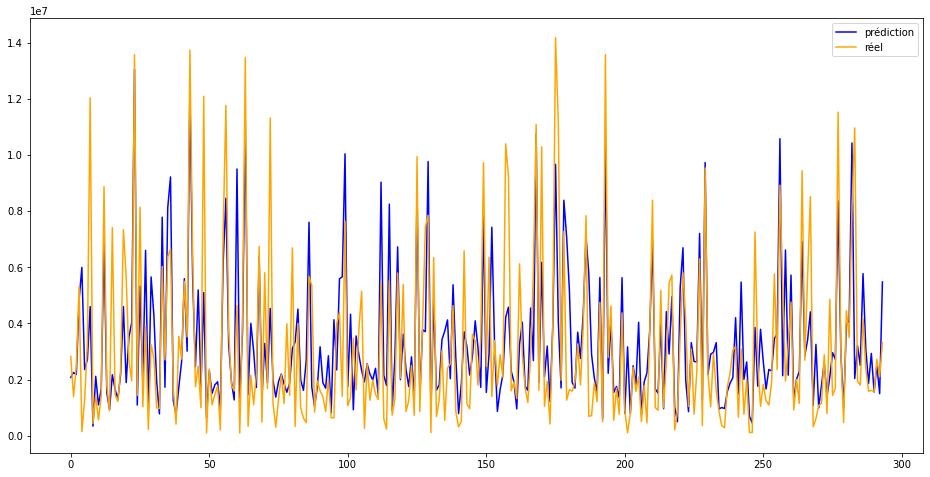

In [15]:
# Test du modèle pour prédire 'SiteEnergyUse(kBtu)'
model_forest_grid = test_model(X, Y, 0.2, rand_init, 
                               num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [16]:
# Test du modèle pour prédire 'ln_consommation'
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False)

# On ajoute une ligne au tableau récapitulatif des tests
add_line_to_modeles(mes_modeles, model_forest_grid, 'model_forest_grid',model_ln)

Temps d'entrainement: 96.7616111
R2 score : 0.5262434553514961
mae : 0.5117599322792787


Le modèle est un peu moins bon pour prédire le logarithme de la consommation que la consommation elle-même.

In [17]:
model_forest_grid[0].best_params_ # Indique le meilleur hyperparamètre

{'n_estimators': 100}

Regardons ce que donne un hyperparamètre 'n_estimators' égal à 200.

Temps d'entrainement: 2.437461400000018
R2 score : 0.558868628537752
mae : 1386073.3732505627


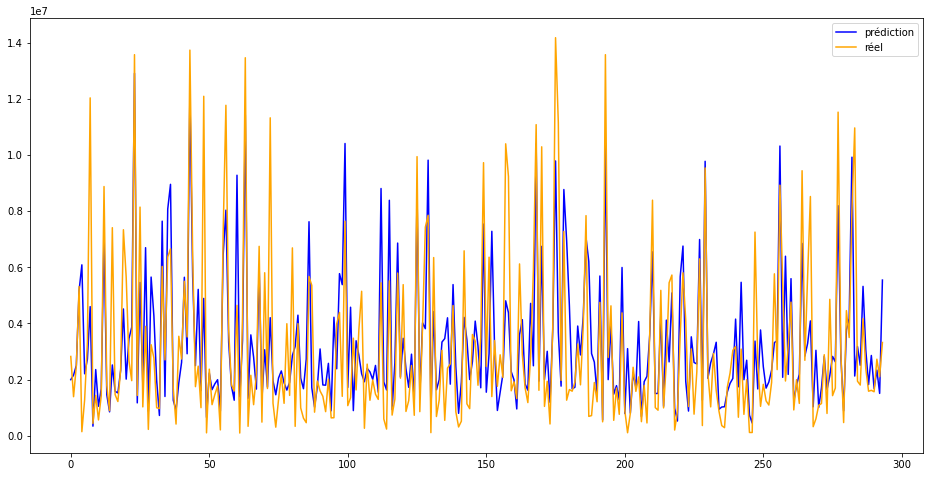

In [18]:
model_forest = RandomForestRegressor(n_estimators=200) 

model_forest_test = test_model(X, Y, 0.2, rand_init, 
                          num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model_forest, True)

Le r2_score entre model_forest_grid et model_forest_test diffère de moins de un centième. En fait, lors de la préparation de ce notebook, d'autre tests on été effectués et changer de 'n_estimators' ne modifie quasiment pas les prédictions.

In [19]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model_forest, False)
add_line_to_modeles(mes_modeles, model_forest_test, 'model_forest', model_ln)

Temps d'entrainement: 2.3511894000000098
R2 score : 0.520144304408378
mae : 0.512932689546969


Regardons l'influence du jeu d'entraînement sur l'efficacité du modèle. Pour cela on va simplement tester différentes valeur de 'random_state' lors du 'train_test_split'.

In [20]:
model = RandomForestRegressor(n_estimators=200)
for i in [1,7,13,16,21]:    
    L = test_model(X, Y, 0.2, i, num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, False, False)
    print("random_state =",i)
    print('R2 score : ', L[2])

random_state = 1
R2 score :  0.5834198450961636
random_state = 7
R2 score :  0.5152898007005565
random_state = 13
R2 score :  0.6344754181613209
random_state = 16
R2 score :  0.6290827555874163
random_state = 21
R2 score :  0.6103545765693223


Les variations sont importantes, jusqu'à un dizième d'écart soit bien plus que ce qui à été observé pour un changement de 'n_estimators'. Les données d'entraînement ont donc un fort impact sur la qualité du modèle.

## Kernel Ridge Regression

Nous testerons deux noyaux différents: un noyau linéaire, et un noyau gaussien.

### Noyau linéaire

In [21]:
# grille d'hyperparamètres
alpha_range = np.logspace(-2, 2, 5)


gamma_range = np.logspace(-2, 1, 4)


param_grid = {'alpha': alpha_range, 'gamma': gamma_range}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        kernel_ridge.KernelRidge(kernel='linear'),
        param_grid,
        cv=cv)

Temps d'entrainement: 2.719322500000004
R2 score : 0.5026557476895532
mae : 1511068.320838416


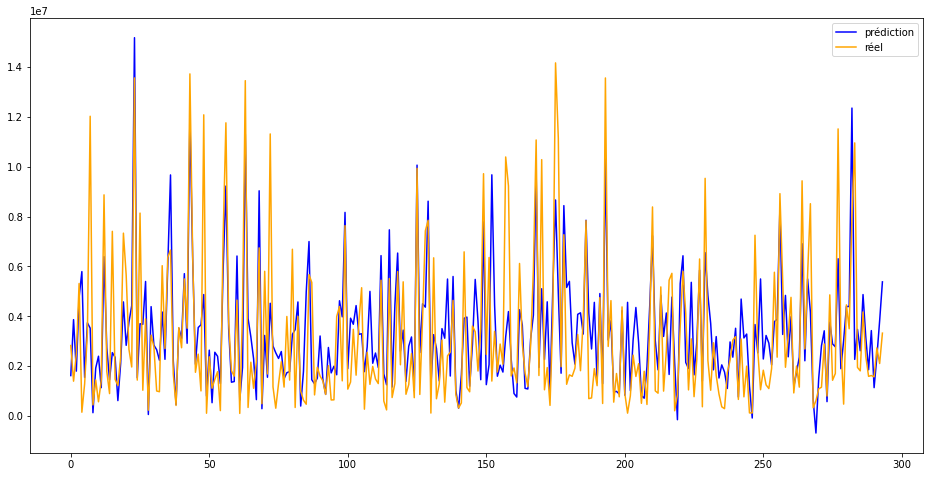

In [22]:
model_krr_lin_grid = test_model(X, Y, 0.2, rand_init, 
                                num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [23]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False)
add_line_to_modeles(mes_modeles, model_krr_lin_grid, 'model_krr_lin_grid', model_ln)

Temps d'entrainement: 2.6657749999999965
R2 score : 0.43644262791126787
mae : 0.5681456101624764


In [24]:
model_krr_lin_grid[0].best_params_

{'alpha': 0.1, 'gamma': 0.01}

Temps d'entrainement: 0.043161599999990585
R2 score : 0.486591435382575
mae : 1528577.885411784


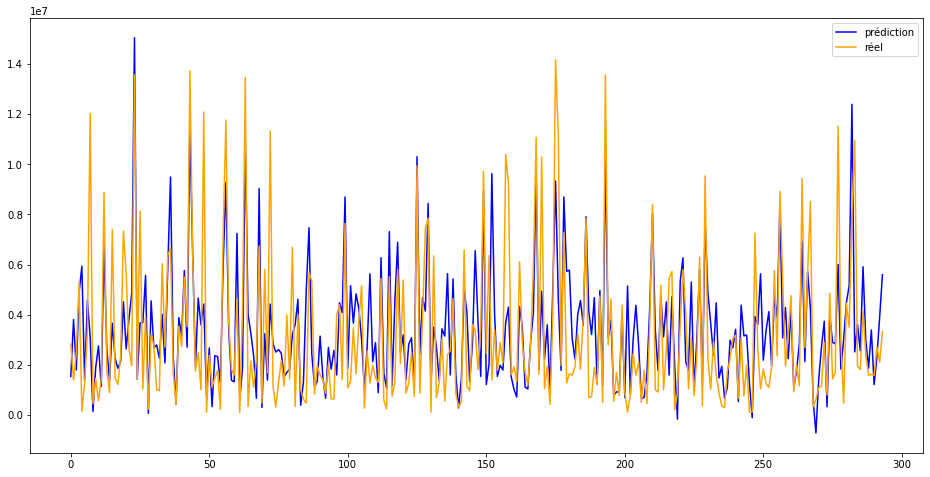

In [25]:
model = kernel_ridge.KernelRidge(alpha=1.0, kernel='linear', gamma=0.1)

model_krr_lin = test_model(X, Y, 0.2, rand_init, num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, True)

Pour ce modèle, le changement d'hyperparamètres à eu un impact un peu plus fort que pour les forêts aléatoires.

In [26]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, False, False)
add_line_to_modeles(mes_modeles, model_krr_lin, 'model_krr_lin', model_ln)

### Noyau Gaussien

Temps d'entrainement: 3.4569582000000025
R2 score : 0.5256743556162454
mae : 1461169.101229314


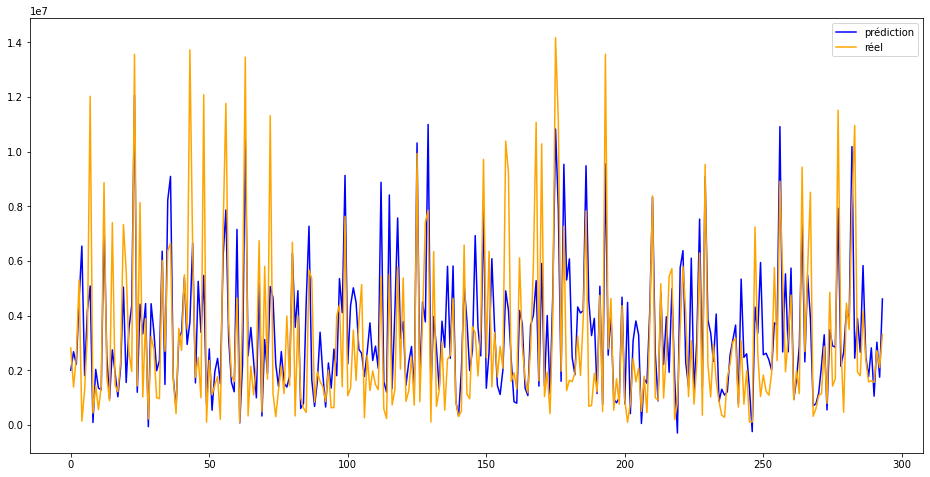

In [27]:
grid_pred = GridSearchCV(
        kernel_ridge.KernelRidge(kernel='rbf'),
        param_grid,
        cv=cv)
model_krr_rbf_grid = test_model(X, Y, 0.2, rand_init, 
                           num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [28]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False)
add_line_to_modeles(mes_modeles, model_krr_rbf_grid, 'model_krr_rbf_grid', model_ln)

Temps d'entrainement: 3.392010099999993
R2 score : 0.13437628864547868
mae : 0.5788905897447446


In [29]:
model_krr_rbf_grid[0].best_params_

{'alpha': 0.01, 'gamma': 0.01}

Temps d'entrainement: 0.05205630000000383
R2 score : 0.27110790075626945
mae : 1637439.9827167906


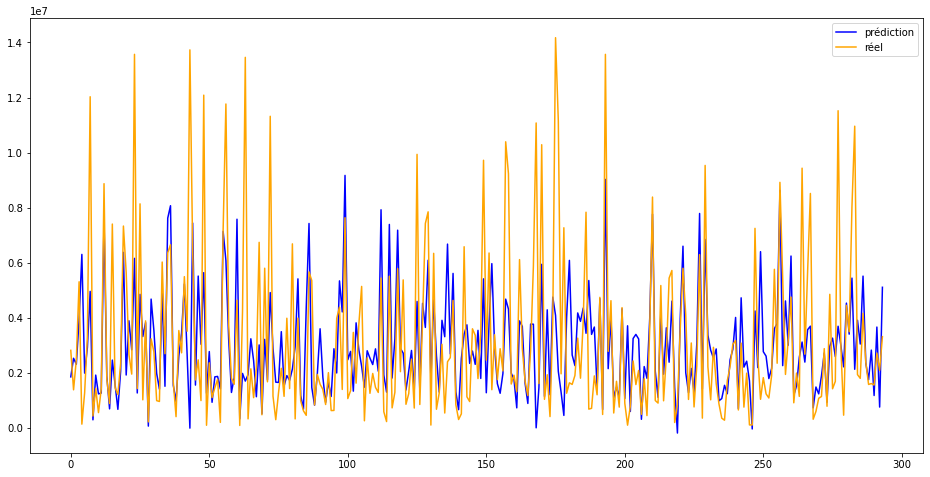

In [30]:
model = kernel_ridge.KernelRidge(alpha=1.0, kernel='rbf', gamma=0.1)

model_krr_rbf = test_model(X, Y, 0.2, rand_init, num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, True)

Cette fois-ci, des hyperparamètres non optimaux ont considérablement diminués la qualités des prédictions.

In [31]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, False, False)
add_line_to_modeles(mes_modeles, model_krr_rbf, 'model_krr_rbf', model_ln)

Regardons l'influence du jeu d'entraînement sur l'efficacité du modèle.

In [32]:
model = kernel_ridge.KernelRidge(alpha=0.01, kernel='rbf', gamma=0.01)
for i in [1,7,13,16,21]:    
    L = test_model(X, Y, 0.2, i, num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, False, False)
    print("random_state =",i)
    print('R2 score : ', L[2])

random_state = 1
R2 score :  0.5985986887600804
random_state = 7
R2 score :  0.5101605047986015
random_state = 13
R2 score :  0.6782485346774288
random_state = 16
R2 score :  0.6023522635509807
random_state = 21
R2 score :  0.5593158809256371


Pour ce modèle aussi, on constate une forte dépendance au jeu d'entraînement. On ne fera pas ce test pour les autres modèles.

A partir de maintenant il y aura moins de commentaires sur les tests effectués, on analysera les résultats à la fin du notebook à l'aide du tableau récapitulatif. 

## ElasticNet

In [33]:
# grille d'hyperparamètres
param_grid = {'alpha': [0.01, 0.1, 1], 'l1_ratio' : [0.25, 0.5, 0.75], 'random_state': [0, 5, 10, 20]}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        ElasticNet(),
        param_grid,
        cv=cv)

Temps d'entrainement: 2.2014371999999867
R2 score : 0.5027069766616157
mae : 1514184.442639482


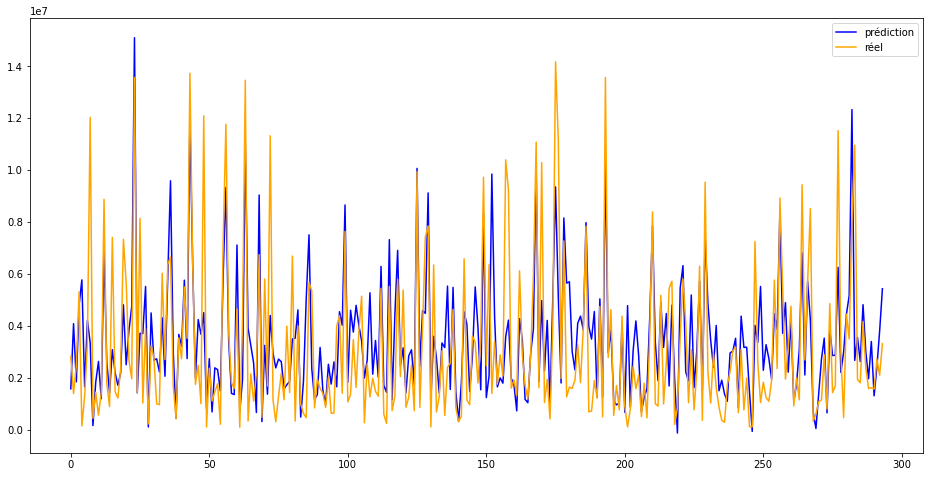

In [34]:
model_elasticnet_grid = test_model(X, Y, 0.2, rand_init, 
                                   num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [35]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False)
add_line_to_modeles(mes_modeles, model_elasticnet_grid, 'model_elasticnet_grid', model_ln)

Temps d'entrainement: 0.590750700000001
R2 score : 0.42520459229025587
mae : 0.5766197060792432


In [36]:
model_elasticnet_grid[0].best_params_

{'alpha': 0.01, 'l1_ratio': 0.25, 'random_state': 0}

Temps d'entrainement: 0.011164700000023231
R2 score : 0.5243964444121487
mae : 1614328.0710183552


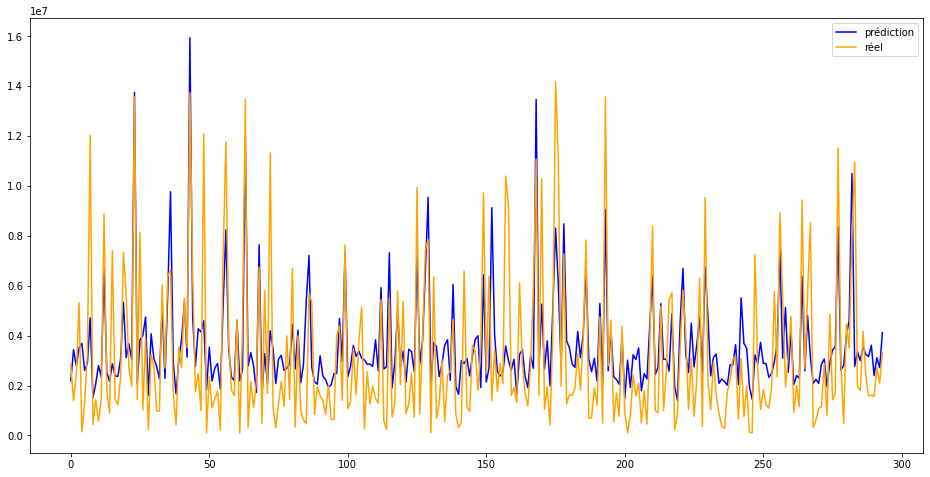

In [37]:
model = ElasticNet(alpha=1, l1_ratio=0.5, random_state=7)

model_elasticnet = test_model(X, Y, 0.2, rand_init, 
                               num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, True)

In [38]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, False, False)
add_line_to_modeles(mes_modeles, model_elasticnet, 'model_elasticnet', model_ln)

## Gradient boosting

En ce qui concerne la méthode de Gradient boosting, des tests préliminaires ont montrés que le modèle de la bibliothèque xgboost donnait de meilleurs résultats que celui de scikit-learn, donc nous utiliserons xgboost. 

In [39]:
n_estimators_range = [100, 200, 300, 400, 500]

reg_lambda_range = [1, 2]

gamma_range = [0, 1]

max_depth_range = [1, 2, 3, 4]

# grille d'hyperparamètres
param_grid = {'n_estimators': n_estimators_range, 'reg_lambda': reg_lambda_range, 'gamma': gamma_range, 'max_depth': max_depth_range}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        xgb.XGBRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 30.33994610000002
R2 score : 0.5394740947490726
mae : 1439486.8469895748


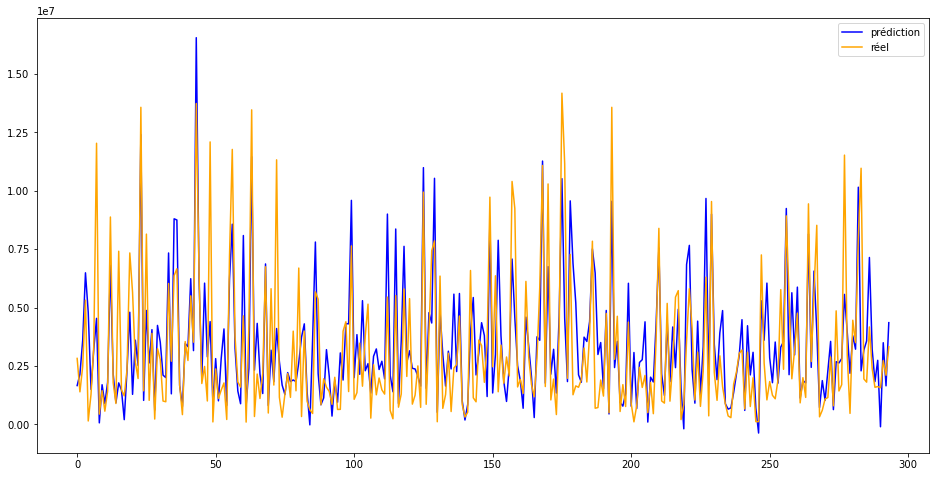

In [40]:
model_xgb_grid = test_model(X, Y, 0.2, rand_init, 
                            num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [41]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_xgb_grid, 'model_xgb_grid', model_ln)

In [42]:
model_xgb_grid[0].best_params_

{'gamma': 1, 'max_depth': 4, 'n_estimators': 100, 'reg_lambda': 1}

Temps d'entrainement: 0.07040470000004007
R2 score : 0.4682738974587647
mae : 1496525.2062918388


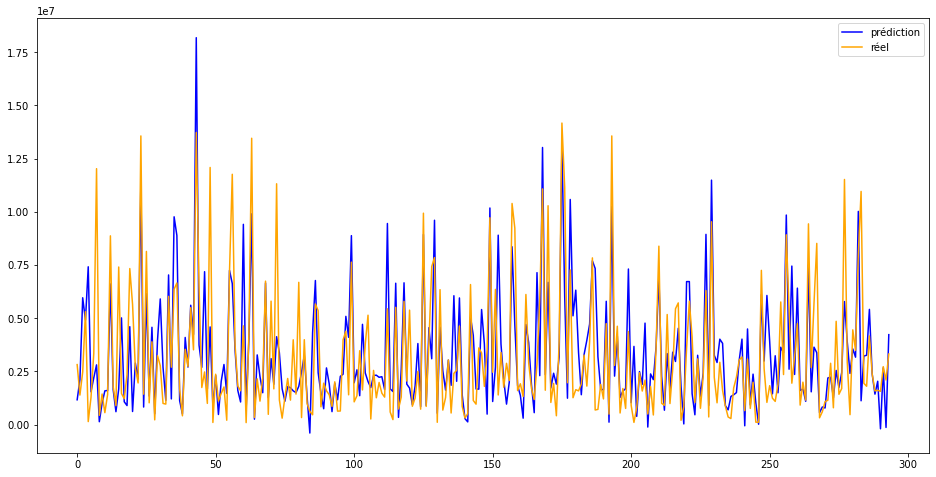

In [43]:
model = xgb.XGBRegressor(n_estimators=200, reg_lambda=1, gamma=0, max_depth=3)

model_xgb = test_model(X, Y, 0.2, rand_init, num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, True)

In [44]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, model, False, False)
add_line_to_modeles(mes_modeles, model_xgb, 'model_xgb', model_ln)

## Réseaux de neurones

Les réseaux de neurones seront implémentés à l'aide de la bibliothèque tensorflow.

Ces modèles s'intégraient mal à la fonction test_model, donc nous procéderons différemment. En particulier nous prédirons uniquement 'SiteEnergyUse(kBtu)'.

In [45]:
import tensorflow as tf

In [46]:
# Création des jeux d'entrainement et de test
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size=0.2, random_state=rand_init)

# Préprocessing des données
ct = make_column_transformer((num_encoder, var_num_encoder),(categ_encoder, var_categ_encoder))
ct.fit(X_train)
X_train_encoder = ct.transform(X_train)
Ytrain_tf = tf.convert_to_tensor(Y_train)

In [47]:
# Une fonction pour tester les modèles
def test_neuralnetwork_model(model, X_test, Y_test):
    y_pred = model.predict(ct.transform(X_test))
    R2 = metrics.r2_score(Y_test, y_pred)
    mae = metrics.mean_absolute_error(Y_test, y_pred)
    print( "R2 score : {}".format(R2))
    print( "mae : {}".format(mae))

On peut faire varier énormément de chose dans un réseau de neurones:
<ul>
    <li>Le nombre de couche.</li>
    <li>Le nombre de neurone par couche.</li>
    <li>La fonction d'activation à la fin de chaque couche.</li>
    <li>L'"optimizers", la métric et la fonction de perte.</li>
    <li>Le "learning_rate" de l'"optimizers".</li>
    <li>Le nombre "epochs".</li>
</ul>

Mais on ne peut pas recourir à la fonction GridSearchCV de la bibliothèque scikit-learn comme précédemment. Du coup, des dizaines de tests ont été effectués et seulement quelques un figure dans ce notebook. En particulier tous les tests présentés ici sont effectués avec l'"optimizers" Adam, car il semblerait que ce soit le meilleur, et comportent des fonctions d'activation linéaires ou "relu".

La métrique utilisée pour compiler sera 'mae' car il n'y a pas de 'r2_score'.

Le fait que nous ne fassions pas de validation croisée est problématique. Si les réseaux de neurones ne donnent pas des résultats clairement supérieurs aux autres modèles, alors nous ne les prendrons pas en compte pour le choix final.

In [48]:
# Création du modèle
model_1 = tf.keras.Sequential([tf.keras.layers.Dense(100),
                              tf.keras.layers.Dense(10),
                              tf.keras.layers.Dense(1)])
# Compilation
model_1.compile(loss='mae',
               optimizer=tf.keras.optimizers.Adam(),
               metrics='mae')
# Fit
model_1.fit(X_train_encoder,Ytrain_tf, epochs=100)

Epoch 1/100


C:\Users\tony.mathieux\anaconda3\envs\machine_learning\lib\site-packages\tensorflow\python\framework\indexed_slices.py:447: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Reshape:0", shape=(None, 100), dtype=float32), dense_shape=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(


37/37 [==============================] - 1s 2ms/step - loss: 3608980.5000 - mae: 3608980.5000
Epoch 2/100
37/37 [==============================] - 0s 1ms/step - loss: 3608971.0000 - mae: 3608971.0000
Epoch 3/100
37/37 [==============================] - 0s 2ms/step - loss: 3608944.0000 - mae: 3608944.0000
Epoch 4/100
37/37 [==============================] - 0s 2ms/step - loss: 3608886.7500 - mae: 3608886.7500
Epoch 5/100
37/37 [==============================] - 0s 2ms/step - loss: 3608785.2500 - mae: 3608785.2500
Epoch 6/100
37/37 [==============================] - 0s 2ms/step - loss: 3608627.5000 - mae: 3608627.5000
Epoch 7/100
37/37 [==============================] - 0s 2ms/step - loss: 3608400.0000 - mae: 3608400.0000
Epoch 8/100
37/37 [==============================] - 0s 2ms/step - loss: 3608093.5000 - mae: 3608093.5000
Epoch 9/100
37/37 [==============================] - 0s 2ms/step - loss: 3607694.5000 - mae: 3607694.5000
Epoch 10/100
37/37 [==============================] - 0s 1

37/37 [==============================] - 0s 2ms/step - loss: 3073997.5000 - mae: 3073997.5000
Epoch 78/100
37/37 [==============================] - 0s 2ms/step - loss: 3058828.7500 - mae: 3058828.7500
Epoch 79/100
37/37 [==============================] - 0s 2ms/step - loss: 3043653.5000 - mae: 3043653.5000
Epoch 80/100
37/37 [==============================] - 0s 2ms/step - loss: 3028397.0000 - mae: 3028397.0000
Epoch 81/100
37/37 [==============================] - 0s 2ms/step - loss: 3013152.7500 - mae: 3013152.7500
Epoch 82/100
37/37 [==============================] - 0s 2ms/step - loss: 2997738.0000 - mae: 2997738.0000
Epoch 83/100
37/37 [==============================] - 0s 2ms/step - loss: 2982418.7500 - mae: 2982418.7500
Epoch 84/100
37/37 [==============================] - 0s 2ms/step - loss: 2966749.7500 - mae: 2966749.7500
Epoch 85/100
37/37 [==============================] - 0s 2ms/step - loss: 2951076.2500 - mae: 2951076.2500
Epoch 86/100
37/37 [==============================

In [49]:
test_neuralnetwork_model(model_1, X_test, Y_test)

R2 score : -0.4292258947022798
mae : 2329017.2642964628


C'est très mauvais comparé aux autres modèles.

Pour le test suivant, nous allons simplement changer le 'learning_rate', qui vaut 0.01 par défaut.

In [50]:
# Création du modèle
model_2 = tf.keras.Sequential([tf.keras.layers.Dense(100),
                              tf.keras.layers.Dense(10),
                              tf.keras.layers.Dense(1)])
# Compilation
model_2.compile(loss='mae',
               optimizer=tf.keras.optimizers.Adam(learning_rate=0.1),
               metrics='mae')
# Fit
model_2.fit(X_train_encoder,Ytrain_tf, epochs=100)

Epoch 1/100
 1/37 [..............................] - ETA: 9s - loss: 3991894.0000 - mae: 3991894.0000

C:\Users\tony.mathieux\anaconda3\envs\machine_learning\lib\site-packages\tensorflow\python\framework\indexed_slices.py:447: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_1/dense_3/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_1/dense_3/embedding_lookup_sparse/Reshape:0", shape=(None, 100), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_1/dense_3/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(


37/37 [==============================] - 0s 2ms/step - loss: 3548196.5000 - mae: 3548196.5000
Epoch 2/100
37/37 [==============================] - 0s 2ms/step - loss: 2584647.5000 - mae: 2584647.5000
Epoch 3/100
37/37 [==============================] - 0s 2ms/step - loss: 1763975.5000 - mae: 1763975.5000
Epoch 4/100
37/37 [==============================] - 0s 2ms/step - loss: 1604368.3750 - mae: 1604368.3750
Epoch 5/100
37/37 [==============================] - 0s 2ms/step - loss: 1545996.2500 - mae: 1545996.2500
Epoch 6/100
37/37 [==============================] - 0s 2ms/step - loss: 1526029.3750 - mae: 1526029.3750
Epoch 7/100
37/37 [==============================] - 0s 2ms/step - loss: 1519879.7500 - mae: 1519879.7500
Epoch 8/100
37/37 [==============================] - 0s 2ms/step - loss: 1518581.2500 - mae: 1518581.2500
Epoch 9/100
37/37 [==============================] - 0s 2ms/step - loss: 1508293.8750 - mae: 1508293.8750
Epoch 10/100
37/37 [==============================] - 0s 2

37/37 [==============================] - 0s 2ms/step - loss: 1475261.7500 - mae: 1475261.7500
Epoch 78/100
37/37 [==============================] - 0s 2ms/step - loss: 1473920.0000 - mae: 1473920.0000
Epoch 79/100
37/37 [==============================] - 0s 2ms/step - loss: 1477429.0000 - mae: 1477429.0000
Epoch 80/100
37/37 [==============================] - 0s 2ms/step - loss: 1473945.8750 - mae: 1473945.8750
Epoch 81/100
37/37 [==============================] - 0s 2ms/step - loss: 1485186.7500 - mae: 1485186.7500
Epoch 82/100
37/37 [==============================] - 0s 2ms/step - loss: 1479888.7500 - mae: 1479888.7500
Epoch 83/100
37/37 [==============================] - 0s 2ms/step - loss: 1479995.3750 - mae: 1479995.3750
Epoch 84/100
37/37 [==============================] - 0s 2ms/step - loss: 1482039.3750 - mae: 1482039.3750
Epoch 85/100
37/37 [==============================] - 0s 2ms/step - loss: 1480090.1250 - mae: 1480090.1250
Epoch 86/100
37/37 [==============================

In [51]:
test_neuralnetwork_model(model_2, X_test, Y_test)

R2 score : 0.541547013574092
mae : 1342589.8679587552


Ce simple changement de learning_rate à considérablement amélioré le modèle.

Revenons au learning_rate de 0.01, ajoutons des neurones à la deuxième couche et changeons de fonctions d'activation.

In [52]:
# Création du modèle
model_3 = tf.keras.Sequential([tf.keras.layers.Dense(100,activation='relu'),
                              tf.keras.layers.Dense(100,activation='relu'),
                              tf.keras.layers.Dense(1)])
# Compilation
model_3.compile(loss='mae',
               optimizer=tf.keras.optimizers.Adam(),
               metrics='mae')
# Fit
model_3.fit(X_train_encoder,Ytrain_tf, epochs=100)

Epoch 1/100


C:\Users\tony.mathieux\anaconda3\envs\machine_learning\lib\site-packages\tensorflow\python\framework\indexed_slices.py:447: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_2/dense_6/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_2/dense_6/embedding_lookup_sparse/Reshape:0", shape=(None, 100), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_2/dense_6/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(


37/37 [==============================] - 0s 2ms/step - loss: 3608980.5000 - mae: 3608980.5000
Epoch 2/100
37/37 [==============================] - 0s 2ms/step - loss: 3608959.0000 - mae: 3608959.0000
Epoch 3/100
37/37 [==============================] - 0s 2ms/step - loss: 3608879.2500 - mae: 3608879.2500
Epoch 4/100
37/37 [==============================] - 0s 2ms/step - loss: 3608673.2500 - mae: 3608673.2500
Epoch 5/100
37/37 [==============================] - 0s 2ms/step - loss: 3608260.2500 - mae: 3608260.2500
Epoch 6/100
37/37 [==============================] - 0s 2ms/step - loss: 3607556.2500 - mae: 3607556.2500
Epoch 7/100
37/37 [==============================] - 0s 2ms/step - loss: 3606484.7500 - mae: 3606484.7500
Epoch 8/100
37/37 [==============================] - 0s 2ms/step - loss: 3604971.5000 - mae: 3604971.5000
Epoch 9/100
37/37 [==============================] - 0s 2ms/step - loss: 3602940.2500 - mae: 3602940.2500
Epoch 10/100
37/37 [==============================] - 0s 2

37/37 [==============================] - 0s 2ms/step - loss: 2384021.7500 - mae: 2384021.7500
Epoch 78/100
37/37 [==============================] - 0s 2ms/step - loss: 2368480.7500 - mae: 2368480.7500
Epoch 79/100
37/37 [==============================] - 0s 2ms/step - loss: 2352996.2500 - mae: 2352996.2500
Epoch 80/100
37/37 [==============================] - 0s 2ms/step - loss: 2337783.2500 - mae: 2337783.2500
Epoch 81/100
37/37 [==============================] - 0s 2ms/step - loss: 2322629.0000 - mae: 2322629.0000
Epoch 82/100
37/37 [==============================] - 0s 2ms/step - loss: 2307942.7500 - mae: 2307942.7500
Epoch 83/100
37/37 [==============================] - 0s 2ms/step - loss: 2293475.7500 - mae: 2293475.7500
Epoch 84/100
37/37 [==============================] - 0s 2ms/step - loss: 2278940.5000 - mae: 2278940.5000
Epoch 85/100
37/37 [==============================] - 0s 2ms/step - loss: 2264629.0000 - mae: 2264629.0000
Epoch 86/100
37/37 [==============================

In [53]:
test_neuralnetwork_model(model_3, X_test, Y_test)

R2 score : 0.25616929554275225
mae : 1731022.0823202722


C'est mieux que le modèle 1, mais moins bien que le 2.

Maintenant ajoutons une couche.

In [54]:
# Créations du modèle
model_4 = tf.keras.Sequential([tf.keras.layers.Dense(100,activation='relu'),
                              tf.keras.layers.Dense(100,activation='relu'),
                               tf.keras.layers.Dense(100,activation='relu'),
                              tf.keras.layers.Dense(1)])
# Compilation
model_4.compile(loss='mae',
               optimizer=tf.keras.optimizers.Adam(),
               metrics='mae')
# Fit
model_4.fit(X_train_encoder,Ytrain_tf, epochs=100)

Epoch 1/100


C:\Users\tony.mathieux\anaconda3\envs\machine_learning\lib\site-packages\tensorflow\python\framework\indexed_slices.py:447: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_3/dense_9/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_3/dense_9/embedding_lookup_sparse/Reshape:0", shape=(None, 100), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_3/dense_9/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(


37/37 [==============================] - 0s 2ms/step - loss: 3608978.7500 - mae: 3608978.7500
Epoch 2/100
37/37 [==============================] - 0s 2ms/step - loss: 3608855.2500 - mae: 3608855.2500
Epoch 3/100
37/37 [==============================] - 0s 2ms/step - loss: 3607830.5000 - mae: 3607830.5000
Epoch 4/100
37/37 [==============================] - 0s 2ms/step - loss: 3603256.7500 - mae: 3603256.7500
Epoch 5/100
37/37 [==============================] - 0s 2ms/step - loss: 3589592.2500 - mae: 3589592.2500
Epoch 6/100
37/37 [==============================] - 0s 2ms/step - loss: 3557978.0000 - mae: 3557978.0000
Epoch 7/100
37/37 [==============================] - 0s 2ms/step - loss: 3496834.5000 - mae: 3496834.5000
Epoch 8/100
37/37 [==============================] - 0s 2ms/step - loss: 3394687.2500 - mae: 3394687.2500
Epoch 9/100
37/37 [==============================] - 0s 2ms/step - loss: 3244028.2500 - mae: 3244028.2500
Epoch 10/100
37/37 [==============================] - 0s 2

37/37 [==============================] - 0s 2ms/step - loss: 1492197.5000 - mae: 1492197.5000
Epoch 78/100
37/37 [==============================] - 0s 2ms/step - loss: 1490994.7500 - mae: 1490994.7500
Epoch 79/100
37/37 [==============================] - 0s 2ms/step - loss: 1490548.2500 - mae: 1490548.2500
Epoch 80/100
37/37 [==============================] - 0s 2ms/step - loss: 1489786.5000 - mae: 1489786.5000
Epoch 81/100
37/37 [==============================] - 0s 2ms/step - loss: 1489379.0000 - mae: 1489379.0000
Epoch 82/100
37/37 [==============================] - 0s 2ms/step - loss: 1489675.1250 - mae: 1489675.1250
Epoch 83/100
37/37 [==============================] - 0s 2ms/step - loss: 1488058.7500 - mae: 1488058.7500
Epoch 84/100
37/37 [==============================] - 0s 2ms/step - loss: 1487058.5000 - mae: 1487058.5000
Epoch 85/100
37/37 [==============================] - 0s 2ms/step - loss: 1486914.8750 - mae: 1486914.8750
Epoch 86/100
37/37 [==============================

In [55]:
test_neuralnetwork_model(model_4, X_test, Y_test)

R2 score : 0.5595019270506605
mae : 1278254.7815131294


On est maintenant au niveau du modèle 2.

Combinons maintenant les améliorations effectuées pour les modèles 2 et 4.

In [56]:
# Création du modèle
model_5 = tf.keras.Sequential([tf.keras.layers.Dense(100,activation='relu'),
                              tf.keras.layers.Dense(100,activation='relu'),
                               tf.keras.layers.Dense(100,activation='relu'),
                              tf.keras.layers.Dense(1)])
# Compilation
model_5.compile(loss='mae',
               optimizer=tf.keras.optimizers.Adam(learning_rate=0.1),
               metrics='mae')
# Fit
model_5.fit(X_train_encoder,Ytrain_tf, epochs=100)

Epoch 1/100


C:\Users\tony.mathieux\anaconda3\envs\machine_learning\lib\site-packages\tensorflow\python\framework\indexed_slices.py:447: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_4/dense_13/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_4/dense_13/embedding_lookup_sparse/Reshape:0", shape=(None, 100), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_4/dense_13/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(


37/37 [==============================] - 0s 2ms/step - loss: 2650309.0000 - mae: 2650309.0000
Epoch 2/100
37/37 [==============================] - 0s 2ms/step - loss: 1683022.1250 - mae: 1683022.1250
Epoch 3/100
37/37 [==============================] - 0s 2ms/step - loss: 1555803.5000 - mae: 1555803.5000
Epoch 4/100
37/37 [==============================] - 0s 2ms/step - loss: 1543955.3750 - mae: 1543955.3750
Epoch 5/100
37/37 [==============================] - 0s 2ms/step - loss: 1513306.5000 - mae: 1513306.5000
Epoch 6/100
37/37 [==============================] - 0s 2ms/step - loss: 1496044.2500 - mae: 1496044.2500
Epoch 7/100
37/37 [==============================] - 0s 2ms/step - loss: 1460700.1250 - mae: 1460700.1250
Epoch 8/100
37/37 [==============================] - 0s 2ms/step - loss: 1482169.7500 - mae: 1482169.7500
Epoch 9/100
37/37 [==============================] - 0s 2ms/step - loss: 1455275.6250 - mae: 1455275.6250
Epoch 10/100
37/37 [==============================] - 0s 2

37/37 [==============================] - 0s 2ms/step - loss: 818337.5625 - mae: 818337.5625
Epoch 79/100
37/37 [==============================] - 0s 2ms/step - loss: 778412.8750 - mae: 778412.8750
Epoch 80/100
37/37 [==============================] - 0s 2ms/step - loss: 789597.9375 - mae: 789597.9375
Epoch 81/100
37/37 [==============================] - 0s 2ms/step - loss: 783448.8750 - mae: 783448.8750
Epoch 82/100
37/37 [==============================] - 0s 2ms/step - loss: 743491.3750 - mae: 743491.3750
Epoch 83/100
37/37 [==============================] - 0s 2ms/step - loss: 740780.0625 - mae: 740780.0625
Epoch 84/100
37/37 [==============================] - 0s 2ms/step - loss: 748028.3125 - mae: 748028.3125
Epoch 85/100
37/37 [==============================] - 0s 2ms/step - loss: 764201.9375 - mae: 764201.9375
Epoch 86/100
37/37 [==============================] - 0s 2ms/step - loss: 728068.4375 - mae: 728068.4375
Epoch 87/100
37/37 [==============================] - 0s 2ms/step - 

In [57]:
test_neuralnetwork_model(model_5, X_test, Y_test)

R2 score : 0.46062106841836115
mae : 1461004.3679817517


On a un problème d'overfitting: sur le jeu d'entraînement la 'mae' descend à environ 650000, mais elle est environ 2 fois plus élevée sur le jeu de test.

Supprimons donc une couche et des neurones sur la deuxième couche.

In [58]:
# Création du modèle
model_6 = tf.keras.Sequential([tf.keras.layers.Dense(100),
                              tf.keras.layers.Dense(10,activation='relu'),
                              tf.keras.layers.Dense(1)])
# Compilation
model_6.compile(loss='mae',
               optimizer=tf.keras.optimizers.Adam(learning_rate=0.1),
               metrics='mae')
# Fit
model_6.fit(X_train_encoder,Ytrain_tf, epochs=100)

Epoch 1/100
 1/37 [..............................] - ETA: 8s - loss: 3225794.0000 - mae: 3225794.0000

C:\Users\tony.mathieux\anaconda3\envs\machine_learning\lib\site-packages\tensorflow\python\framework\indexed_slices.py:447: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential_5/dense_17/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential_5/dense_17/embedding_lookup_sparse/Reshape:0", shape=(None, 100), dtype=float32), dense_shape=Tensor("gradient_tape/sequential_5/dense_17/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(


37/37 [==============================] - 0s 2ms/step - loss: 3570024.7500 - mae: 3570024.7500
Epoch 2/100
37/37 [==============================] - 0s 2ms/step - loss: 2969800.2500 - mae: 2969800.2500
Epoch 3/100
37/37 [==============================] - 0s 2ms/step - loss: 2518002.5000 - mae: 2518002.5000
Epoch 4/100
37/37 [==============================] - 0s 2ms/step - loss: 1910622.5000 - mae: 1910622.5000
Epoch 5/100
37/37 [==============================] - 0s 2ms/step - loss: 1609683.7500 - mae: 1609683.7500
Epoch 6/100
37/37 [==============================] - 0s 2ms/step - loss: 1556016.3750 - mae: 1556016.3750
Epoch 7/100
37/37 [==============================] - 0s 2ms/step - loss: 1538824.8750 - mae: 1538824.8750
Epoch 8/100
37/37 [==============================] - 0s 2ms/step - loss: 1524483.0000 - mae: 1524483.0000
Epoch 9/100
37/37 [==============================] - 0s 2ms/step - loss: 1523123.0000 - mae: 1523123.0000
Epoch 10/100
37/37 [==============================] - 0s 2

37/37 [==============================] - 0s 2ms/step - loss: 1435099.0000 - mae: 1435099.0000
Epoch 78/100
37/37 [==============================] - 0s 2ms/step - loss: 1435828.6250 - mae: 1435828.6250
Epoch 79/100
37/37 [==============================] - 0s 2ms/step - loss: 1432434.0000 - mae: 1432434.0000
Epoch 80/100
37/37 [==============================] - 0s 2ms/step - loss: 1439825.8750 - mae: 1439825.8750
Epoch 81/100
37/37 [==============================] - 0s 2ms/step - loss: 1437522.8750 - mae: 1437522.8750
Epoch 82/100
37/37 [==============================] - 0s 2ms/step - loss: 1431305.7500 - mae: 1431305.7500
Epoch 83/100
37/37 [==============================] - 0s 2ms/step - loss: 1430765.5000 - mae: 1430765.5000
Epoch 84/100
37/37 [==============================] - 0s 2ms/step - loss: 1431762.8750 - mae: 1431762.8750
Epoch 85/100
37/37 [==============================] - 0s 2ms/step - loss: 1431199.2500 - mae: 1431199.2500
Epoch 86/100
37/37 [==============================

In [59]:
test_neuralnetwork_model(model_6, X_test, Y_test)

R2 score : 0.5211695228936499
mae : 1332229.5855621938


Il n'y a plus d'overfitting et la performance est du même ordre que pour les modèles 2 et 4.

Finalement, le modèle 4 est presque aussi bon que les forêts aléatoires, sauf que nous n'avons pas effectué de validation croisée, donc nous excluons les réseaux de neurones des choix possibles et nous ne les testerons pas sur les autres jeux de données.

# Données: data avec ENERGY STAR Score

Attention, l'ENERGY Star Score n'a pas été mesuré pour tous les bâtiments du jeu de données.

In [60]:
X = data[['PrimaryPropertyType', 'CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 'PropertyGFABuilding(s)','ENERGYSTARScore',
       'LargestPropertyUseType', 'LargestPropertyUseTypeGFA','SecondLargestPropertyUseType', 'SecondLargestPropertyUseTypeGFA',
       'ThirdLargestPropertyUseType', 'ThirdLargestPropertyUseTypeGFA','distance_from_City_Hall','proportion_elec']]

X = X.loc[~(X['ENERGYSTARScore'].isna())]
Y = data['SiteEnergyUse(kBtu)'].loc[X.index]
Y_ln = data['ln_consommation'].loc[X.index]

In [61]:
# Préprocessing des données
num_encoder = StandardScaler()

var_num_encoder = ['CouncilDistrictCode','YearBuilt','NumberofBuildings','NumberofFloors','PropertyGFAParking','PropertyGFABuilding(s)','ENERGYSTARScore',
       'LargestPropertyUseTypeGFA','SecondLargestPropertyUseTypeGFA','ThirdLargestPropertyUseTypeGFA','distance_from_City_Hall','proportion_elec']

categ_encoder = OneHotEncoder(handle_unknown='ignore')

var_categ_encoder = ['PrimaryPropertyType', 'LargestPropertyUseType', 'SecondLargestPropertyUseType','ThirdLargestPropertyUseType']

## Random forest

In [62]:
# grille d'hyperparamètres
param_grid = {'n_estimators': [100,200,300,400,500]}

# initialiser la validation croisée
grid_pred = GridSearchCV(
        RandomForestRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 39.46040519999997
R2 score : 0.795722160736434
mae : 1002811.6526156947


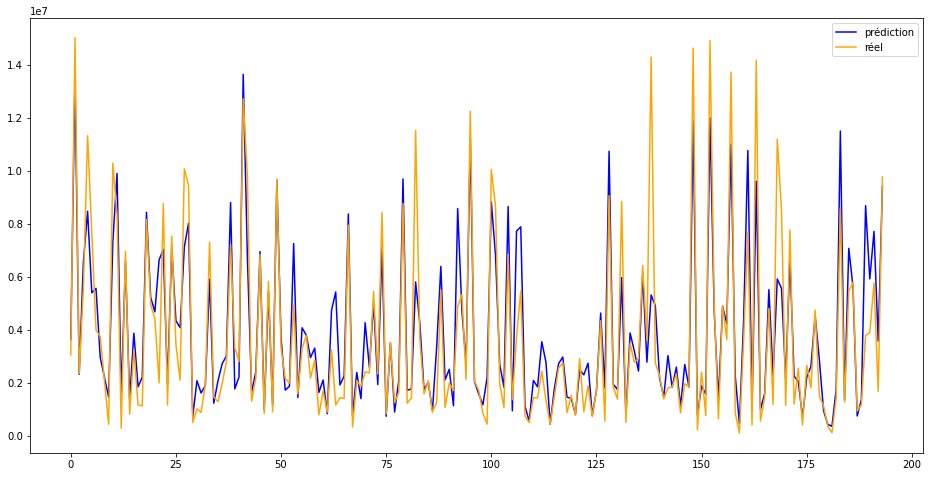

In [63]:
model_starscore_forest_grid = test_model(X, Y, 0.2, rand_init, 
                                         num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

On remarque que la prise en compte de l'ENERGY STAR Score à considérablement amélioré la qualité du modèle. 

In [64]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_starscore_forest_grid, 'model_starscore_forest_grid', model_ln)

## Kernel Ridge Regression

### Noyau linéaire

In [65]:
# grille d'hyperparamètres
alpha_range = np.logspace(-2, 2, 5)


gamma_range = np.logspace(-2, 1, 4)


param_grid = {'alpha': alpha_range, 'gamma': gamma_range}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        kernel_ridge.KernelRidge(kernel='linear'),
        param_grid,
        cv=cv)

Temps d'entrainement: 1.1471993000000111
R2 score : 0.7262782064344009
mae : 1251451.6144674094


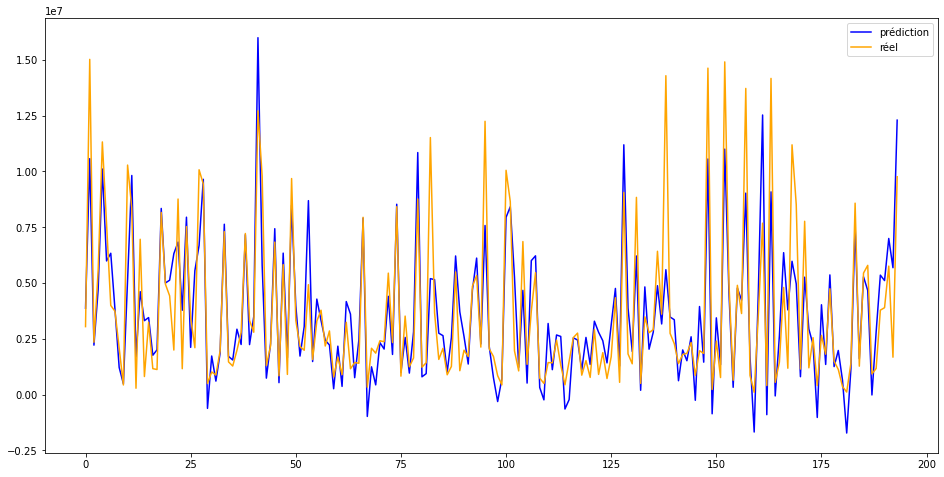

In [66]:
model_starscore_krr_lin_grid = test_model(X, Y, 0.2, rand_init, 
                                          num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [67]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_starscore_krr_lin_grid, 'model_starscore_krr_lin_grid', model_ln)

### Noyau Gaussien

Temps d'entrainement: 1.506413899999984
R2 score : 0.802700233816668
mae : 957818.748287516


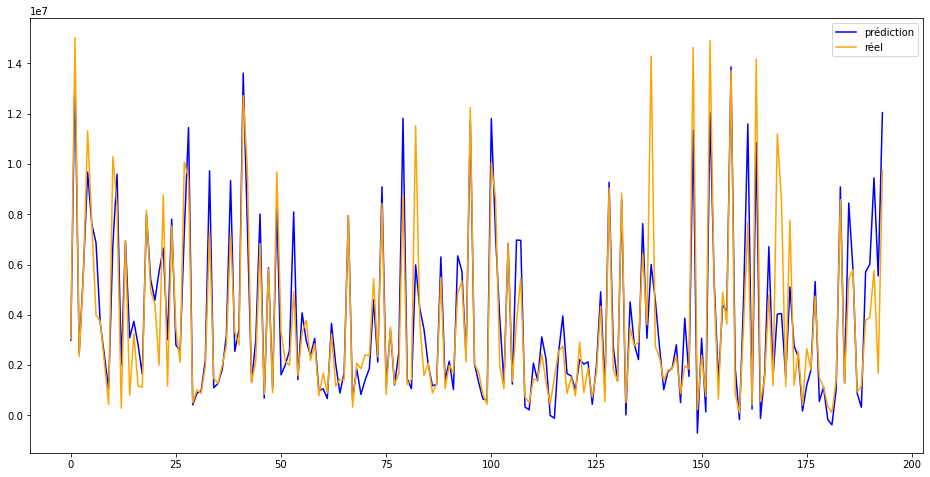

In [68]:
grid_pred = GridSearchCV(
        kernel_ridge.KernelRidge(kernel='rbf'),
        param_grid,
        cv=cv)
model_starscore_krr_rbf = test_model(X, Y, 0.2, rand_init, 
                                     num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [69]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_starscore_krr_rbf, 'model_starscore_krr_rbf_grid', model_ln)

## ElasticNet

In [70]:
# grille d'hyperparamètres
param_grid = {'alpha': [0.01, 0.1, 1], 'l1_ratio' : [0.25, 0.5, 0.75], 'random_state': [0, 5, 10, 20]}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        ElasticNet(),
        param_grid,
        cv=cv)

Temps d'entrainement: 2.00727820000003
R2 score : 0.7293033581592041
mae : 1212535.2895446054


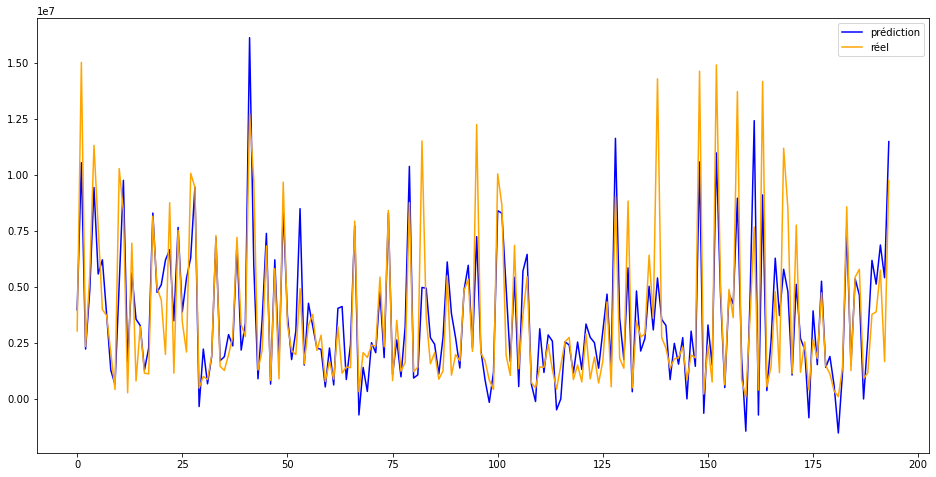

In [71]:
model_starscore_elasticnet_grid = test_model(X, Y, 0.2, rand_init, 
                                             num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [72]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_starscore_elasticnet_grid, 'model_starscore_elasticnet_grid', model_ln)

## Gradient boosting

In [73]:
n_estimators_range = [100, 200, 300, 400, 500]

reg_lambda_range = [1, 2]

gamma_range = [0, 1]

max_depth_range = [1, 2, 3, 4]

# grille d'hyperparamètres
param_grid = {'n_estimators': n_estimators_range, 'reg_lambda': reg_lambda_range, 'gamma': gamma_range, 'max_depth': max_depth_range}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        xgb.XGBRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 26.899987699999997
R2 score : 0.8053393090425911
mae : 1032648.0829754189


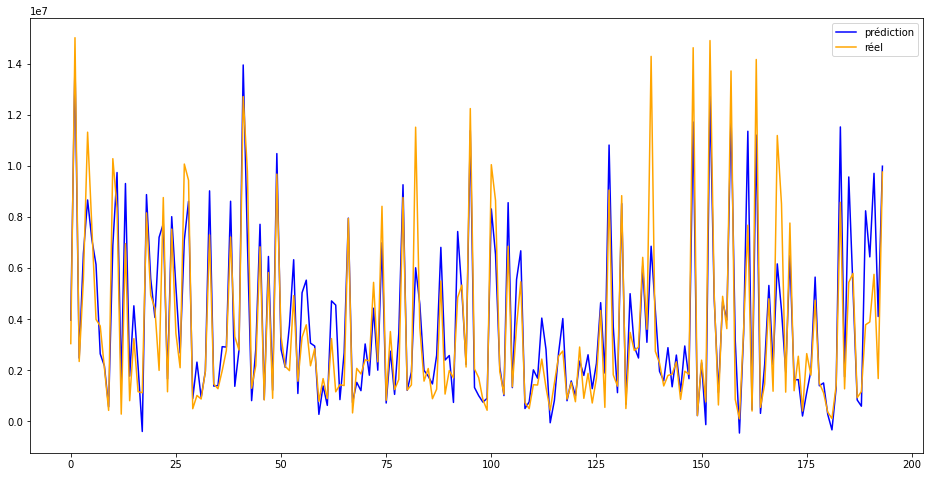

In [74]:
model_starscore_xgb_grid = test_model(X, Y, 0.2, rand_init, 
                                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [75]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_starscore_xgb_grid, 'model_starscore_xgb_grid', model_ln)

# Données: df sans ENERGY STAR Score

Passons maintenant à l'autre jeu de données. Nous ne testerons pas de réseaux de neurones mais nous ajoutons des mesures de la feature importance.

In [76]:
Y = df['SiteEnergyUse(kBtu)']
Y_ln = df['ln_consommation']

X = df[['CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 
       'distance_from_City_Hall', 'education', 'leisure', 'lodging', 'mall',
       'medical', 'non refrigerated warehouse', 'office', 'other',
       'refrigerated warehouse', 'restauration', 'services', 'store','proportion_elec']]

Comme X contient beaucoup de zéro, on pourrai être tenter d'effectuer le préprocessing des données avec un MaxAbsScaler() plutôt qu'un StandardScaler(). Cela à été testé lors de la phase de recherche mais à abouti à de moins bons résultats, qui ne figurent pas dans ce notebook. 

In [77]:
# Préprocessing des données pour la fonction test_model
num_encoder = StandardScaler()

var_num_encoder = ['CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 
       'distance_from_City_Hall', 'education', 'leisure', 'lodging', 'mall',
       'medical', 'non refrigerated warehouse', 'office', 'other',
       'refrigerated warehouse', 'restauration', 'services', 'store','proportion_elec']

categ_encoder = OneHotEncoder(handle_unknown='ignore')

var_categ_encoder = []

Comme nous allons faire des mesures de feature importance, nous aurons besoin d'avoir accès aux données d'entraînement et de test.

In [78]:
X_train, X_test, Ytrain, Ytest = train_test_split(X,Y, test_size=0.2, random_state=3)

# Préprocessing des données pour la feature importance local
ct = make_column_transformer(
    (StandardScaler(),['CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 
       'distance_from_City_Hall', 'education', 'leisure', 'lodging', 'mall',
       'medical', 'non refrigerated warehouse', 'office', 'other',
       'refrigerated warehouse', 'restauration', 'services', 'store','proportion_elec']))

ct.fit(X_train)

X_train_scaled = ct.transform(X_train)
X_test_scaled = ct.transform(X_test)

La feature importance locale se mesure sur un individu. On regardera les deux suivants.

In [79]:
num_sample_a = 2
num_sample_b = 4
X_test.iloc[[num_sample_a,num_sample_b]]

,CouncilDistrictCode,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFAParking,distance_from_City_Hall,education,leisure,lodging,mall,medical,non refrigerated warehouse,office,other,refrigerated warehouse,restauration,services,store,proportion_elec
799,3,1968.0,1.0,5.0,0.0,4.289025,40809.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.62
620,2,1953.0,1.0,1.0,0.0,4.352567,0.0,0.0,0.0,0.0,0.0,15000.0,0.0,0.0,0.0,0.0,0.0,25000.0,0.37


Gardons en tête que le premier est de type 'education', et le deuxième de types 'store' et 'non refrigerated warehouse'.

## Random forest

In [80]:
# grille d'hyperparamètres
param_grid = {'n_estimators': [100,200,300,400,500]}

# initialiser la validation croisée
grid_pred = GridSearchCV(
        RandomForestRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 26.879884600000025
R2 score : 0.5313752436756156
mae : 1435467.9327388303


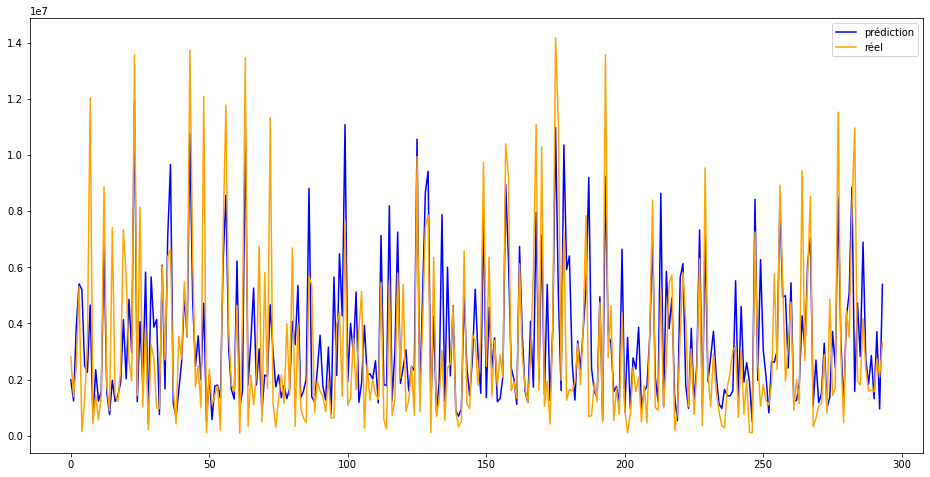

In [81]:
model_df_forest_grid = test_model(X, Y, 0.2, rand_init, 
                                         num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [82]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_forest_grid, 'model_df_forest_grid', model_ln)

### Feature importance

In [83]:
# On commence par créer un modèle de forêtes aléatoires
model = RandomForestRegressor(n_estimators=200)
model.fit(X_train_scaled, Ytrain)

RandomForestRegressor(n_estimators=200)

Commençons par regarder la feature importance global.

<AxesSubplot:>

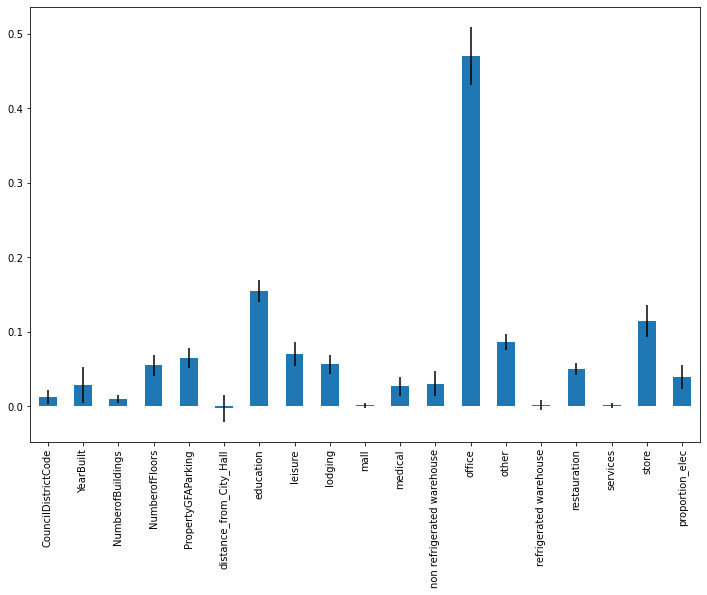

In [84]:
from sklearn.inspection import permutation_importance


result = permutation_importance(
    model, X_test_scaled, Ytest, n_repeats=10, random_state=42, n_jobs=2
)

forest_importances = pd.Series(result.importances_mean, index=X.columns)
plt.figure(figsize=(12,8))
forest_importances.plot.bar(yerr=result.importances_std)

Passons maintenat à la feature importance locale. Dans la phase de recherche on a testé les modules shap et lime. Or la combinaison de shap et de xgboost à générée des erreurs et des warnings qui compliquaient l'automatisation des tests. Pour ce premier modèle nous utiliserons shap et lime, pour les comparer, mais par la suite nous n'utiliserons que lime.

In [85]:
import shap
import lime

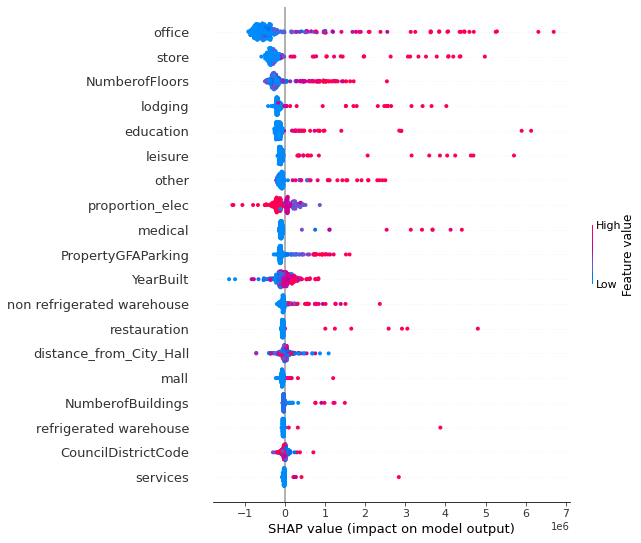

<Figure size 576x576 with 0 Axes>

<Figure size 576x576 with 0 Axes>

In [86]:
# Commençons avec shap
# On créer un 'TreeExplainer'
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test_scaled)

# On trace le résumer pour tous les bâtiments
shap.summary_plot(shap_values, X_test_scaled,feature_names=X.columns)
plt.figure(figsize=(8,8))

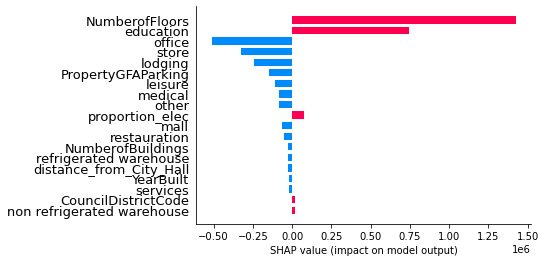

In [87]:
# Cette fois-ci on regarde un bâtiment en particulier, destiné à l'éducation
shap.bar_plot(explainer.shap_values(X_test_scaled[num_sample_a]),feature_names=X.columns, max_display=len(X.columns))

Analysons maintenant la feature importance de ce même bâtiment avec lime. On commence par créer une fonction pour faire cette analyse.

In [88]:
def lime_explanation(model, X_test_scaled, num_sample, num_features):
    lime_explainer = lime.lime_tabular.LimeTabularExplainer(X_test_scaled, mode="regression")
    explanation = lime_explainer.explain_instance(X_test_scaled[num_sample], model.predict, num_features=num_features)
    explanation.show_in_notebook()

In [89]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

Les features 3 et 6 correspondent respectivement à 'NumberoFloors' et 'education'. Comme avec shape, ce sont bien les deux variables avec la plus grande contribution positive (et dans le même ordre). Mais il y a quand même des différences pour certaines variables.

Regardons un autre bâtiment avec lime.

In [90]:
lime_explanation(model, X_test_scaled, num_sample_b, X.columns.shape[0])

Les features 17 et 11 correspondent respectivement  à 'store' et 'non refrigerated warehouse'. Notons qu'à la différence du bâtiment précédent, 'proportion_elec' à une contribution positive.

In [91]:
# Pour rappel
X_test.iloc[[num_sample_a,num_sample_b]]

,CouncilDistrictCode,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFAParking,distance_from_City_Hall,education,leisure,lodging,mall,medical,non refrigerated warehouse,office,other,refrigerated warehouse,restauration,services,store,proportion_elec
799,3,1968.0,1.0,5.0,0.0,4.289025,40809.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.62
620,2,1953.0,1.0,1.0,0.0,4.352567,0.0,0.0,0.0,0.0,0.0,15000.0,0.0,0.0,0.0,0.0,0.0,25000.0,0.37


## Kernel Ridge Regression

### Noyau linéaire

In [92]:
alpha_range = np.logspace(-2, 2, 5)


gamma_range = np.logspace(-2, 1, 4)

# grille d'hyperparamètres
param_grid = {'alpha': alpha_range, 'gamma': gamma_range}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        kernel_ridge.KernelRidge(kernel='linear'),
        param_grid,
        cv=cv)

Temps d'entrainement: 1.204671499999904
R2 score : -0.6313616584347115
mae : 3377257.6283543417


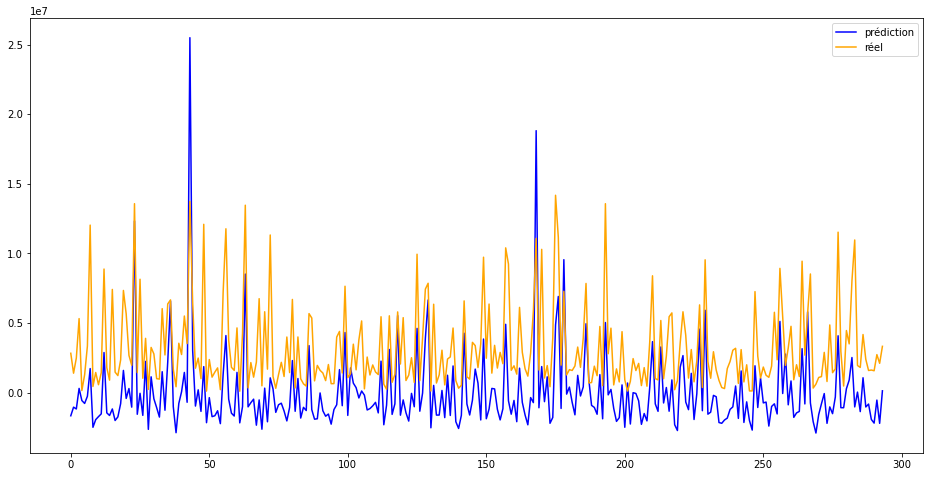

In [93]:
model_df_krr_lin_grid = test_model(X, Y, 0.2, rand_init, 
                                          num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [94]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_krr_lin_grid, 'model_df_krr_lin_grid', model_ln)

### Noyau Gaussien

Temps d'entrainement: 2.267911799999979
R2 score : 0.49507227655455244
mae : 1402966.6635302205


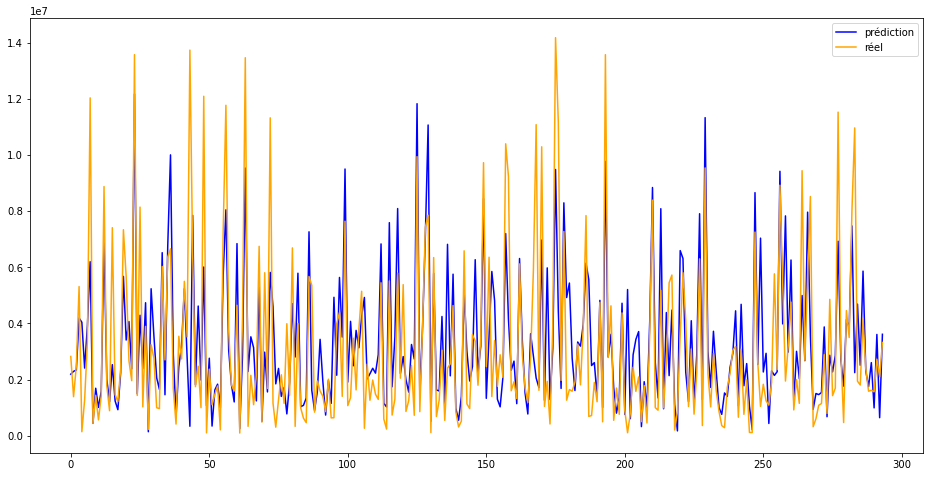

In [95]:
grid_pred = GridSearchCV(
        kernel_ridge.KernelRidge(kernel='rbf'),
        param_grid,
        cv=cv)
model_df_krr_rbf = test_model(X, Y, 0.2, rand_init, 
                                     num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [96]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_krr_rbf, 'model_df_krr_rbf_grid', model_ln)

### Feature importance

In [97]:
model = kernel_ridge.KernelRidge(alpha=1.0, kernel='rbf', gamma=0.01)

model = model.fit(X_train_scaled,Ytrain)

In [98]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

On a le même résultat que pour les forêts aléatoires.

## ElasticNet

In [99]:
# grille d'hyperparamètres
param_grid = {'alpha': [0.01, 0.1, 1], 'l1_ratio' : [0.25, 0.5, 0.75], 'random_state': [0, 5, 10, 20]}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        ElasticNet(),
        param_grid,
        cv=cv)

Temps d'entrainement: 0.17647690000001148
R2 score : 0.482214045557413
mae : 1489912.3269817824


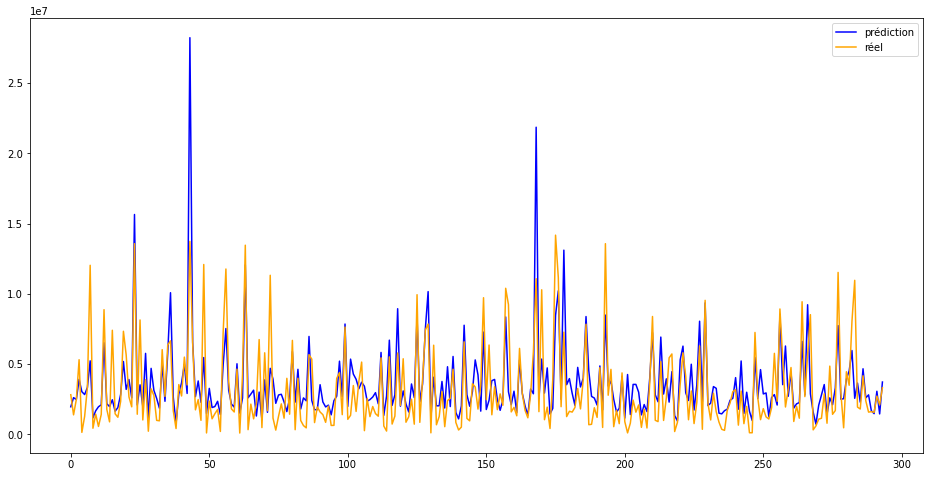

In [100]:
model_df_elasticnet_grid = test_model(X, Y, 0.2, rand_init, 
                                             num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [101]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_elasticnet_grid, 'model_df_elasticnet_grid', model_ln)

### Feature importance

In [102]:
model = ElasticNet(random_state = 5)

model = model.fit(X_train_scaled,Ytrain)

In [103]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

Cette fois-ci il y a des différences avec les forêts aléatoires.

## Gradient boosting

In [104]:
n_estimators_range = [100, 200, 300, 400, 500]

reg_lambda_range = [1, 2]

gamma_range = [0, 1]

max_depth_range = [1, 2, 3, 4]

# grille de paramètres
param_grid = {'n_estimators': n_estimators_range, 'reg_lambda': reg_lambda_range, 'gamma': gamma_range, 'max_depth': max_depth_range}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        xgb.XGBRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 32.95464909999998
R2 score : 0.4428506106199831
mae : 1528214.3683534353


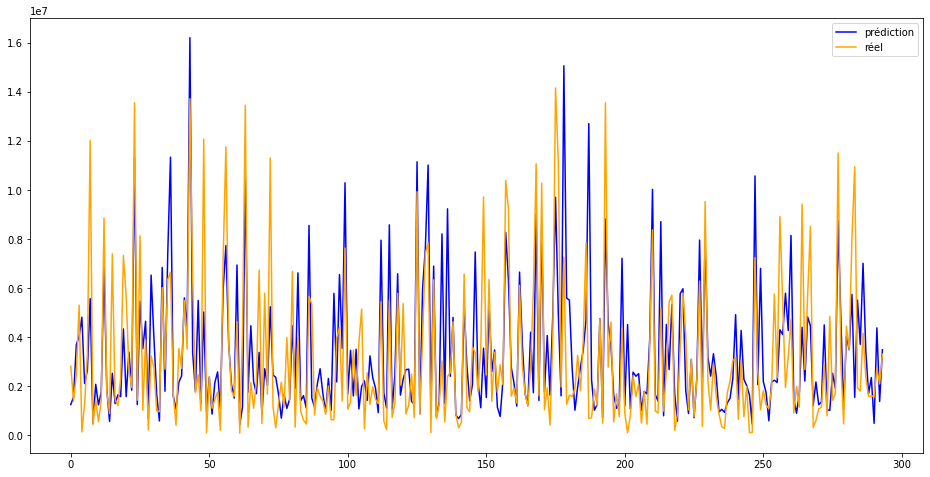

In [105]:
model_df_xgb_grid = test_model(X, Y, 0.2, rand_init, 
                                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [106]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_xgb_grid, 'model_df_xgb_grid', model_ln)

### Feature importance

In [107]:
model = xgb.XGBRegressor(n_estimators=100, reg_lambda=2, gamma=0, max_depth=2)

model = model.fit(X_train_scaled,Ytrain)

In [108]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

# Données: df avec ENERGY STAR Score

In [109]:
X = df[['CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 'ENERGYSTARScore', 
       'distance_from_City_Hall', 'education', 'leisure', 'lodging', 'mall',
       'medical', 'non refrigerated warehouse', 'office', 'other',
       'refrigerated warehouse', 'restauration', 'services', 'store','proportion_elec']]

X = X.loc[~(X['ENERGYSTARScore'].isna())]
Y = df['SiteEnergyUse(kBtu)'].loc[X.index]
Y_ln = df['ln_consommation'].loc[X.index]

In [110]:
# Préprocessing des données pour la fonction test_model
num_encoder = StandardScaler()

var_num_encoder = ['CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 'ENERGYSTARScore', 
       'distance_from_City_Hall', 'education', 'leisure', 'lodging', 'mall',
       'medical', 'non refrigerated warehouse', 'office', 'other',
       'refrigerated warehouse', 'restauration', 'services', 'store','proportion_elec']

categ_encoder = OneHotEncoder(handle_unknown='ignore')

var_categ_encoder = []

In [111]:
X_train, X_test, Ytrain, Ytest = train_test_split(X,Y, test_size=0.2, random_state=3)

# Préprocessing des données pour la feature importance locale
ct = make_column_transformer(
    (StandardScaler(),['CouncilDistrictCode', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFAParking', 'ENERGYSTARScore',
       'distance_from_City_Hall', 'education', 'leisure', 'lodging', 'mall',
       'medical', 'non refrigerated warehouse', 'office', 'other',
       'refrigerated warehouse', 'restauration', 'services', 'store','proportion_elec']))

ct.fit(X_train)

X_train_scaled = ct.transform(X_train)
X_test_scaled = ct.transform(X_test)

## Random forest

In [112]:
# grille d'hyperparamètres
param_grid = {'n_estimators': [100,200,300,400,500]}

# initialiser la validation croisée
grid_pred = GridSearchCV(
        RandomForestRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 15.55400259999999
R2 score : 0.8057358170737821
mae : 943140.2534471385


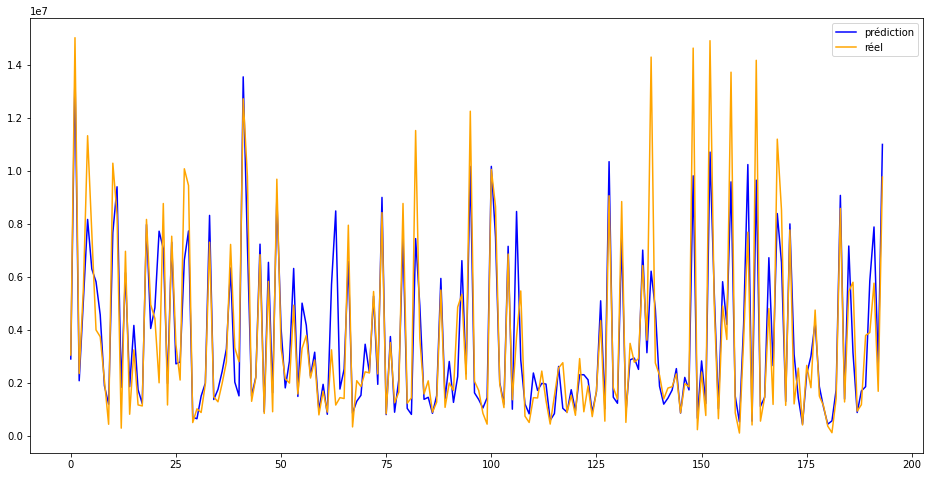

In [113]:
model_df_starscore_forest_grid = test_model(X, Y, 0.2, rand_init, 
                                         num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [114]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_starscore_forest_grid, 'model_df_starscore_forest_grid', model_ln)

### Feature importance

In [115]:
model = RandomForestRegressor(n_estimators=200)
model.fit(X_train_scaled, Ytrain)

RandomForestRegressor(n_estimators=200)

Regardons d'abords la feature importance globale.

<AxesSubplot:>

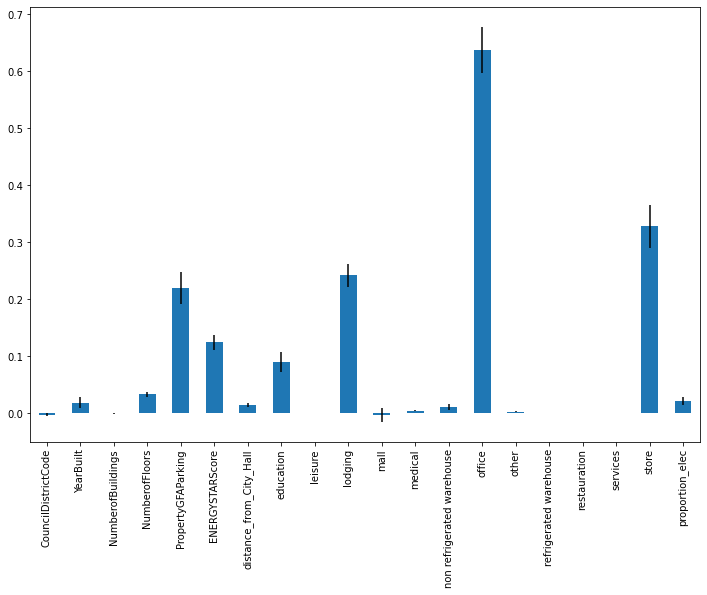

In [116]:
result = permutation_importance(
    model, X_test_scaled, Ytest, n_repeats=10, random_state=42, n_jobs=2
)

forest_importances = pd.Series(result.importances_mean, index=X.columns)
plt.figure(figsize=(12,8))
forest_importances.plot.bar(yerr=result.importances_std)

Puis localement.

In [117]:
X_test.iloc[[num_sample_a, num_sample_b]]

,CouncilDistrictCode,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFAParking,ENERGYSTARScore,distance_from_City_Hall,education,leisure,lodging,mall,medical,non refrigerated warehouse,office,other,refrigerated warehouse,restauration,services,store,proportion_elec
577,2,1971.0,1.0,1.0,0.0,75.0,3.877117,55206.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.62
259,6,1999.0,1.0,3.0,114829.0,96.0,5.128589,0.0,0.0,0.0,0.0,0.0,93893.0,152579.0,0.0,7500.0,0.0,0.0,0.0,0.87


Attention le deuxième bâtiments n'est pas le même que sans l'ENERGY STAR Score.

In [118]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

In [119]:
lime_explanation(model, X_test_scaled, num_sample_b, X.columns.shape[0])

## Kernel Ridge Regression à noyau gaussien

Cette fois-ci nous ne testerons pas de noyau linéaire car les tests effectué jusqu'à présent ont montré qu'il était bien moins performant qu'un noyau gaussien.

Temps d'entrainement: 1.0227591000000302
R2 score : 0.8021612567513517
mae : 945928.9686320891


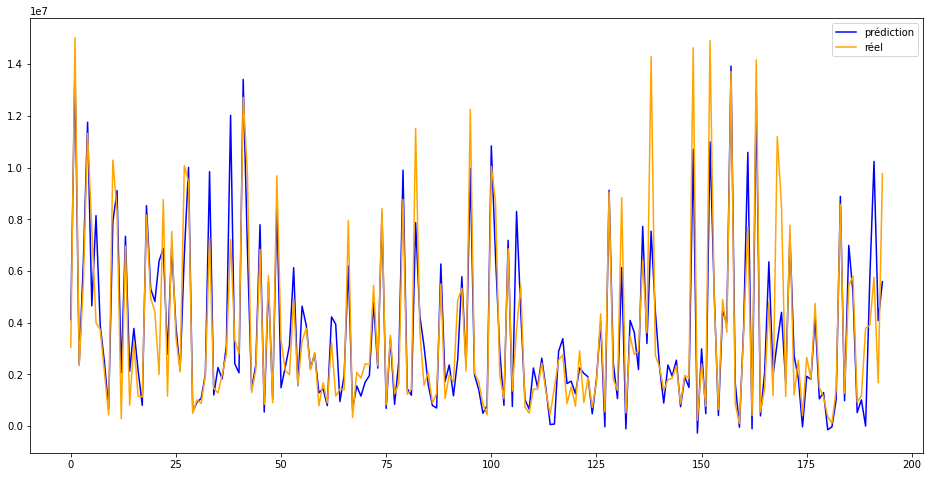

In [120]:
alpha_range = np.logspace(-2, 2, 5)


gamma_range = np.logspace(-2, 1, 4)

# grille d'hyperparamètres
param_grid = {'alpha': alpha_range, 'gamma': gamma_range}

grid_pred = GridSearchCV(
        kernel_ridge.KernelRidge(kernel='rbf'),
        param_grid,
        cv=cv)
model_df_starscore_krr_rbf = test_model(X, Y, 0.2, rand_init, 
                                     num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [121]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_starscore_krr_rbf, 'model_df_starscore_krr_rbf_grid', model_ln)

### Feature importance

In [122]:
model = kernel_ridge.KernelRidge(alpha=1.0, kernel='rbf', gamma=0.01)

model = model.fit(X_train_scaled,Ytrain)

In [123]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

## ElasticNet

In [124]:
# grille d'hyperparamètres
param_grid = {'alpha': [0.01, 0.1, 1], 'l1_ratio' : [0.25, 0.5, 0.75], 'random_state': [0, 5, 10, 20]}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        ElasticNet(),
        param_grid,
        cv=cv)

Temps d'entrainement: 0.2140957999999955
R2 score : 0.7070815472595531
mae : 1201430.5954052093


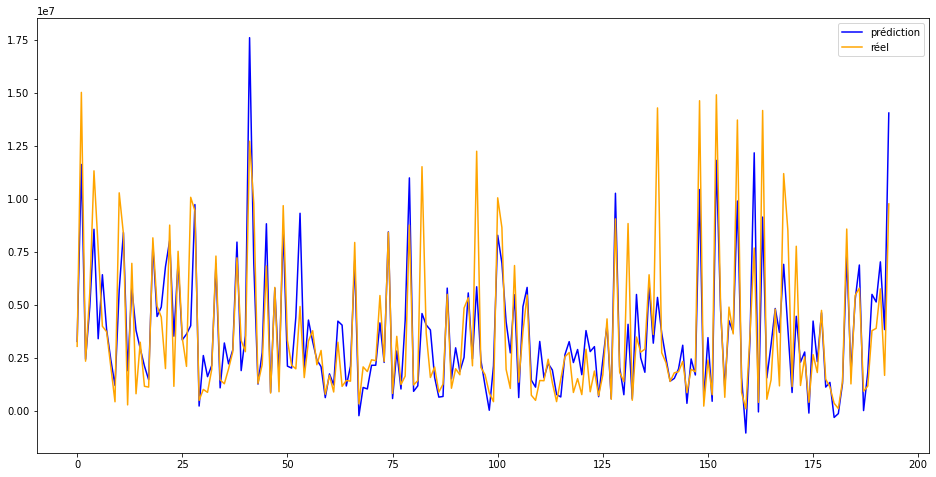

In [125]:
model_df_starscore_elasticnet_grid = test_model(X, Y, 0.2, rand_init, 
                                             num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [126]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_starscore_elasticnet_grid, 'model_df_starscore_elasticnet_grid', model_ln)

### Feature importance

In [127]:
model = ElasticNet(random_state = 5)

model = model.fit(X_train_scaled,Ytrain)

In [128]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

## Gradient boosting

In [129]:
n_estimators_range = [100, 200, 300, 400, 500]

reg_lambda_range = [1, 2]

gamma_range = [0, 1]

max_depth_range = [1, 2, 3, 4]

# grille d'hyperparamètres
param_grid = {'n_estimators': n_estimators_range, 'reg_lambda': reg_lambda_range, 'gamma': gamma_range, 'max_depth': max_depth_range}


# initialiser la validation croisée
grid_pred = GridSearchCV(
        xgb.XGBRegressor(),
        param_grid,
        cv=cv)

Temps d'entrainement: 28.866093100000057
R2 score : 0.8018015733524373
mae : 1026626.5272233852


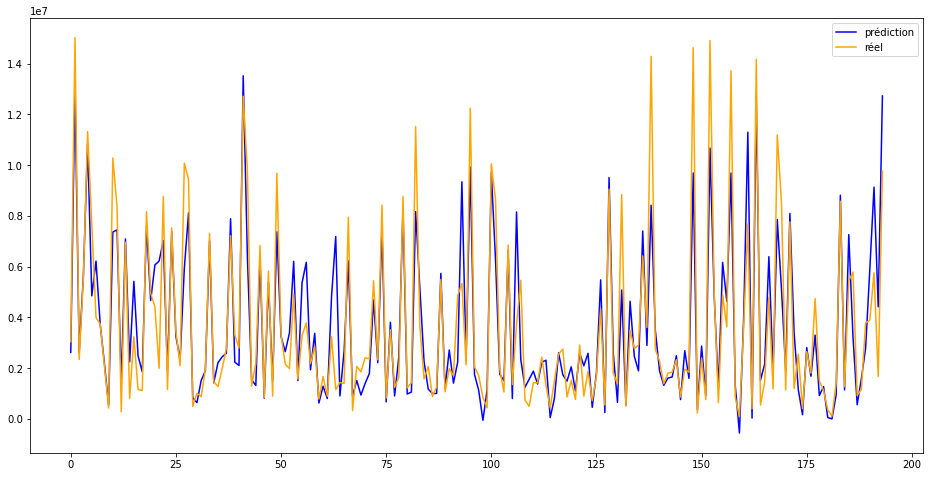

In [130]:
model_df_starscore_xgb_grid = test_model(X, Y, 0.2, rand_init, 
                                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, True)

In [131]:
model_ln = test_model(X, Y_ln, 0.2, rand_init, 
                      num_encoder, var_num_encoder, categ_encoder, var_categ_encoder, grid_pred, False, False)
add_line_to_modeles(mes_modeles, model_df_starscore_xgb_grid, 'model_df_starscore_xgb_grid', model_ln)

### Feature importance

In [132]:
model = xgb.XGBRegressor(n_estimators=100, reg_lambda=2, gamma=0, max_depth=2)

model = model.fit(X_train_scaled,Ytrain)

In [133]:
lime_explanation(model, X_test_scaled, num_sample_a, X.columns.shape[0])

# Choix du modèle

Regardons maintenant le récapitulatif des résultats.

In [134]:
mes_modeles

,modèle,temps d'éxécution,R2_score,mae,temps d'éxécution ln,R2_score ln,mae ln
0,dummy_mean,0.008233,-0.018488,2.468116e+06,0.007052,-0.011573,0.825486
1,dummy_median,0.007552,-0.110103,2.122656e+06,0.007527,-0.005967,0.823180
2,model_forest_grid,106.539619,0.557579,1.385729e+06,96.761611,0.526243,0.511760
3,model_forest,2.437461,0.558869,1.386073e+06,2.351189,0.520144,0.512933
4,model_krr_lin_grid,2.719323,0.502656,1.511068e+06,2.665775,0.436443,0.568146
5,model_krr_lin,0.043162,0.486591,1.528578e+06,0.039479,0.427546,0.577257
6,model_krr_rbf_grid,3.456958,0.525674,1.461169e+06,3.392010,0.134376,0.578891
7,model_krr_rbf,0.052056,0.271108,1.637440e+06,0.051641,-7.351922,1.516515
8,model_elasticnet_grid,2.201437,0.502707,1.514184e+06,0.590751,0.425205,0.576620
9,model_elasticnet,0.011165,0.524396,1.614328e+06,0.012526,0.030678,0.806932


Une première conclusion est qu'avec l'ENERGY STAR Score on peut obtenir de très bons modèles. Mais partons du principe que nous n'aurons pas accès à l'ENERGY STAR Score. 

Le meilleur résultat est obtenu avec les forêts aléatoires, sur le jeu de donnée 'data' (celui avec la structure de base des catégorie de bâtiments), pour prédire directement la consommation et non sa transformation par le logarithme. Mais regardons plus en détails les résultats.

Tous d'abord il est préférable de prédire directement la consommation de la consommation pour tous les modèles (sans ENERGY STAR Score). En particulier, les modèles krr donnent souvent de très mauvais résultats pour prédire 'ln_consommation'.

Remarquons que les écarts entre les modèles ne sont pas très grand et qu'ils sont même inférieurs aux variations de r2_score observés en changeant de jeu d'entraînement. Un point d'amélioration envisageable pour cette étude serait d'imposer lors de la validation croisée des proportions de catégories de bâtiments conforme aux proportion dans le jeu de donnée au départ.

Remarquons aussi que le feature engineering effectué pour simplifier les variables relatives aux catégories de bâtiments à diminué la qualité des prédictions. Par contre l'exécution des tests était plus rapide avec ce jeu de données.

Concernant les temps de calcul, ce n'est un problème que lors lorsqu'on test beaucoup de modèle comme lors de ce projet. Mais une fois le modèle opérationnel, ce n'est plus un problème.

En résumer on recommande d'utiliser un modèle de forêts aléatoires entraîné avec des données de type 'data' et non 'df', afin de prédire 'SiteEnergyUse(kBtu)'.